In [1]:
#from __future__ import print_function
%matplotlib inline
from options import Options
from lib.data import load_data
from lib.model import Ganomaly
import matplotlib.pyplot as plt
import matplotlib as mpl
import torchvision.transforms.functional as F
from torchvision.utils import make_grid

from collections import OrderedDict
import glob,os
import shutil
import time
import numpy as np
from tqdm import tqdm

from torch.autograd import Variable
import torch.optim as optim
import torch.nn as nn
import torch.utils.data
import torchvision.utils as vutils

from lib.networks import NetG, NetD, weights_init
from lib.visualizer import Visualizer
from lib.loss import l2_loss
from lib.evaluate import evaluate

from astropy.table import QTable
import astropy.units as u
import seaborn as sns

In [2]:
mpl.rcParams.update(mpl.rcParamsDefault)
%matplotlib inline
#plt.rcParams["savefig.bbox"] = 'tight'
plt.rcParams.update({'figure.max_open_warning': 0})

In [3]:
t_nihao=QTable.read('nihao_stats_0206.ecsv')
#t_nihao

In [4]:
t_n80=QTable.read('n80_stats_mod.ecsv')
#t_n80

In [5]:
t_SDSS=QTable.read('t_SDSS.ecsv')
#t_SDSS

In [6]:
fontsize=15

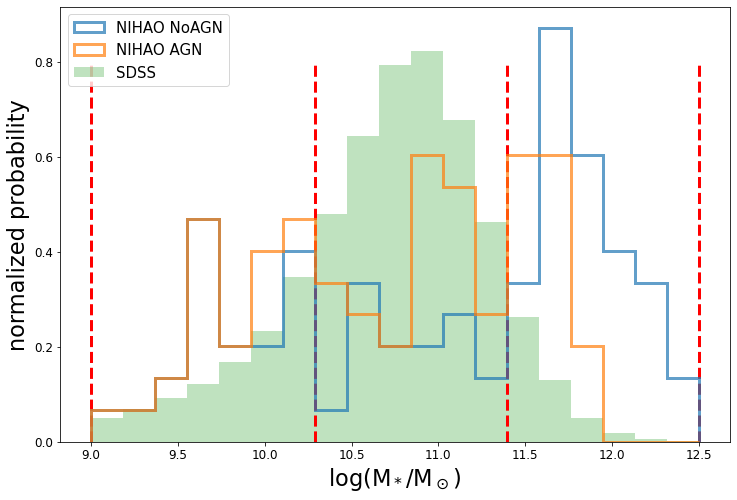

In [7]:
plt.figure(figsize=(12,8))
bins=np.linspace(9,12.5,20)
plt.hist(np.log10(t_nihao['h.star.mass'].value),bins=bins,label='NIHAO NoAGN',density=1,alpha=0.7,histtype='step',lw=3)
plt.hist(np.log10(t_nihao['h.star.mass_bh'].value),bins=bins,label='NIHAO AGN',density=1,alpha=0.7,histtype='step',lw=3)
plt.hist(np.log10(t_SDSS['m']),bins=bins,label='SDSS',density=1,alpha=0.3,lw=3)
plt.vlines((bins[0],bins[7],bins[13],bins[-1]),0,0.8,ls='--',color='r',lw=3)
plt.legend(loc=('upper left'),fontsize=fontsize)
plt.xlabel('$\mathrm{log(M_*/M_\odot)}$',fontsize=fontsize*1.5)
plt.ylabel('normalized probability',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

In [8]:
bins[0],bins[7],bins[13],bins[-1]

(9.0, 10.289473684210526, 11.394736842105264, 12.5)

In [9]:
# plot=[0,1,2,3]=[no plot,plot all, plot particular scores, plot every 1500]
def visualize_list(imagelist,folder='data/SDSS/test/0.normal/',prefix='',suffix='',plot=0,plotname='',plotfeq=1500):
    imagelist.sort()
    
    # prepare dictories
    try:
        os.makedirs('data/SDSS_test/test/1.abnormal')
        # to make sure the stupid dataloader runs. -- I did not wrtie the dataloader myself.
        os.makedirs('data/SDSS_test/train/0.normal')
        shutil.copy(folder+imagelist[0],'data/SDSS_test/train/0.normal/dummy.png')  
    except:
        pass
    
    # remove old images
    try:
        directory = 'data/SDSS_test/test/1.abnormal/'
        for f in os.listdir(directory):
            os.remove(os.path.join(directory, f))
    except:
        pass
    
    # copy new images in
    for name in imagelist:
        shutil.copy(folder+prefix+str(name)+suffix,'data/SDSS_test/test/1.abnormal/'+prefix+str(name)+suffix)
        
        
    class Args:
        dataset='SDSS_test'
        dataroot=''
        batchsize=1   #batch size
        workers=8
        droplast=True
        isize=64      #input image size.
        nc=3          #input image channels
        nz=128        #size of the latent z vector
        ngf=64
        ndf=64
        extralayers=0 #Number of extra layers on gen and disc
        device='gpu'
        gpu_ids='0'
        ngpu=1
        name='output'
        model='ganomaly'
        display_server="http://localhost"
        display_port=8097
        display_id=0
        display=True   #Use visdom
        outf='./output'
        manualseed=-1   #manual seed
        abnormal_class='car'
        proportion=0.1  #Proportion of anomalies in test set
        metric='roc'    #Evaluation metric.')


        print_freq=100  #frequency of showing training results on console
        save_image_freq=100, #frequency of saving real and fake images
    
    
        save_test_images=False #Save test images for demo
        
    
    
        load_weights=True     #Load the pretrained weights
        resume=''             #path to checkpoints (to continue training
        phase='train'         #train, val, test
        iter=0                #Start from iteration
        niter=15              #number of epochs to train for
        beta1=0.5             #momentum term of adam
        lr=0.0002             #initial learning rate for adam
        w_adv=1               #Adversarial loss weight
        w_con=50              #Reconstruction loss weight
        w_enc=1               #Encoder loss weight
        isTrain = False  #True
        opt = None
    
    opt = Args()
    dataloader = load_data(opt)
    model = Ganomaly(opt, dataloader)
    
    mpl.rcParams.update(mpl.rcParamsDefault)
    %matplotlib inline
    #plt.rcParams["savefig.bbox"] = 'tight'
    plt.rcParams.update({'figure.max_open_warning': 0})
    
    def show(imgs,score,name,plotname):
        if not isinstance(imgs, list):
            imgs = [imgs]
        fix, axs = plt.subplots(ncols=len(imgs), squeeze=False)
        #fix.suptitle(name+' $\mathcal{A$ = '+str(score),y=0.77)
        fix.suptitle(plotname+' $\mathcal{A}$ = '+str(score),y=0.77)
        for i, img in enumerate(imgs):
            img = img.detach()
            img = F.to_pil_image(img)
            axs[0, i].imshow(np.asarray(img))
            axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])
    
    
    
    
    with torch.no_grad():
        # Load the weights of netg and netd.
        if model.opt.load_weights:
            path = "./output/ganomaly/SDSS/train/weights/netG_43.pth"
            pretrained_dict = torch.load(path)['state_dict']

            try:
                model.netg.load_state_dict(pretrained_dict)
            except IOError:
                raise IOError("netG weights not found")
            print('   Loaded weights.')

        model.opt.phase = 'test'
        loss_con=nn.L1Loss(reduction='none')
        ascore_array=np.zeros(len(model.dataloader['test']))
        

        for i, data in tqdm(enumerate(model.dataloader['test'], 0),total=len(model.dataloader['test'])):
            model.set_input(data)
            model.fake, latent_i, latent_o = model.netg(model.input)

            error = torch.mean(torch.pow((latent_i-latent_o), 2), dim=1)

            un_ascore = error.reshape(error.size(0)).cpu().detach().numpy()
            # normalize scores
            ascore=(un_ascore-0.0007747652)/(0.93256927-0.0007747652)
            #ascore=(un_ascore-unnormalized_score.min())/(unnormalized_score.max()-unnormalized_score.min())
            ascore_array[i]=ascore
            
            if plot==1:
                real, fake, _ = model.get_current_images()
                loss_img=loss_con(model.fake,model.input).data
                grid=make_grid([real[0],fake[0],loss_img[0]],normalize=True)
                show(grid,ascore,imagelist[i],plotname)
            
            if plot==2:
                #if (ascore>0.05)&(ascore<0.1):
                if (ascore>0.5):
                    real, fake, _ = model.get_current_images()
                    loss_img=loss_con(model.fake,model.input).data
                    grid=make_grid([real[0],fake[0],loss_img[0]],normalize=True)
                    show(grid,ascore,imagelist[i],plotname)
                    
            if plot==3:
                if (i%plotfeq==0):
                    real, fake, _ = model.get_current_images()
                    loss_img=loss_con(model.fake,model.input).data
                    grid=make_grid([real[0],fake[0],loss_img[0]],normalize=True)
                    show(grid,ascore,imagelist[i],plotname)
            
        return ascore_array

In [10]:
# mass bin boundaries
bins[0],bins[7],bins[13],bins[-1]

(9.0, 10.289473684210526, 11.394736842105264, 12.5)

In [11]:
SDSS_low=t_SDSS[(np.log10(t_SDSS['m'])>=bins[0])&(np.log10(t_SDSS['m'])<bins[7])]
SDSS_mid=t_SDSS[(np.log10(t_SDSS['m'])>=bins[7])&(np.log10(t_SDSS['m'])<bins[13])]
SDSS_high=t_SDSS[(np.log10(t_SDSS['m'])>=bins[13])&(np.log10(t_SDSS['m'])<bins[-1])]

In [12]:
NoAGN_low=t_nihao[(np.log10(t_nihao['h.star.mass'].value)>=bins[0])&(np.log10(t_nihao['h.star.mass'].value)<bins[7])]
NoAGN_mid=t_nihao[(np.log10(t_nihao['h.star.mass'].value)>=bins[7])&(np.log10(t_nihao['h.star.mass'].value)<bins[13])]
NoAGN_high=t_nihao[(np.log10(t_nihao['h.star.mass'].value)>=bins[13])&(np.log10(t_nihao['h.star.mass'].value)<bins[-1])]

AGN_low=t_nihao[(np.log10(t_nihao['h.star.mass_bh'].value)>=bins[0])&(np.log10(t_nihao['h.star.mass_bh'].value)<bins[7])]
AGN_mid=t_nihao[(np.log10(t_nihao['h.star.mass_bh'].value)>=bins[7])&(np.log10(t_nihao['h.star.mass_bh'].value)<bins[13])]
AGN_high=t_nihao[(np.log10(t_nihao['h.star.mass_bh'].value)>=bins[13])&(np.log10(t_nihao['h.star.mass_bh'].value)<bins[-1])]

Setting up a new session...


   Loaded weights.


100%|██████████| 12793/12793 [01:46<00:00, 120.64it/s]


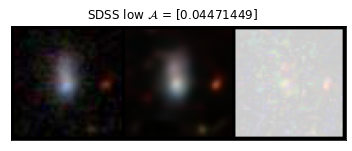

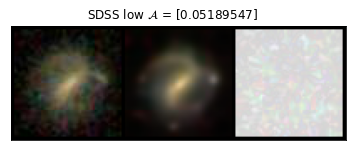

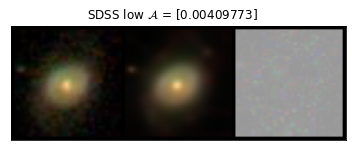

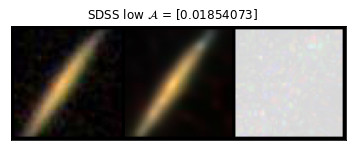

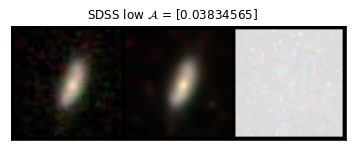

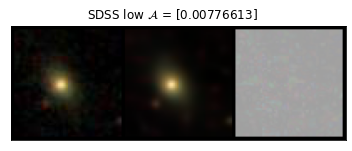

In [13]:
_=visualize_list(SDSS_low['name'],folder='data/SDSS/test/0.normal/',plot=3,suffix='.png',plotname='SDSS low',plotfeq=len(SDSS_low)//5)
# plotting every [plotfeq] images

Setting up a new session...


   Loaded weights.


100%|██████████| 45976/45976 [06:20<00:00, 120.80it/s]


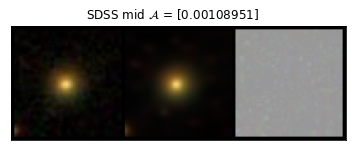

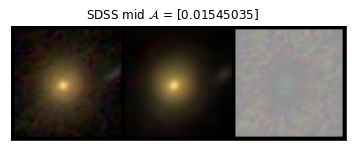

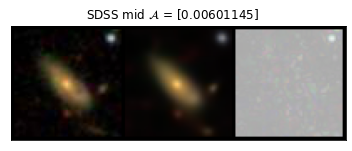

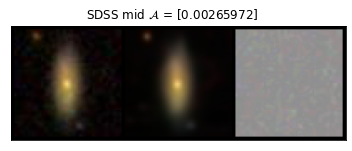

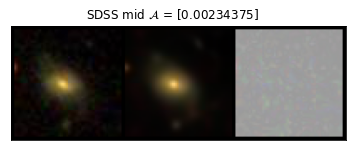

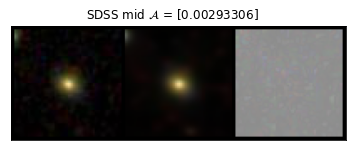

In [14]:
_=visualize_list(SDSS_mid['name'],folder='data/SDSS/test/0.normal/',plot=3,suffix='.png',plotname='SDSS mid',plotfeq=len(SDSS_mid)//5)

Setting up a new session...


   Loaded weights.


100%|██████████| 5572/5572 [00:46<00:00, 119.49it/s]


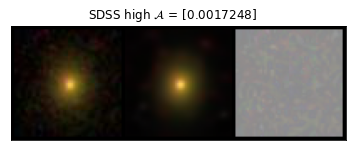

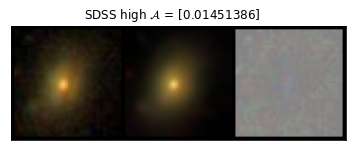

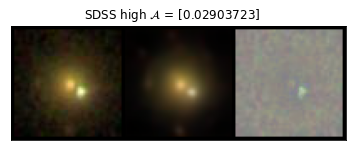

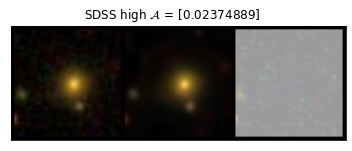

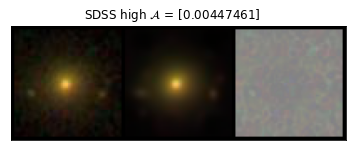

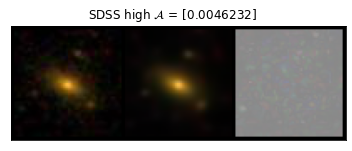

In [15]:
_=visualize_list(SDSS_high['name'],folder='data/SDSS/test/0.normal/',plot=3,suffix='.png',plotname='SDSS high',plotfeq=len(SDSS_high)//5)

In [16]:
def nihao_fn(galaxy,bh=False):
    imagelist=[]
    for name in galaxy:
        if bh==False:
            apd=[os.path.basename(x) for x in glob.glob('data/SDSS/test/1.abnormal/classic_'+name+'*')]
            if len(apd)==0:
                apd=[os.path.basename(x) for x in glob.glob('data/SDSS/test/1.abnormal/ell_wobh_'+name+'*')]
        if bh==True:
            apd=[os.path.basename(x) for x in glob.glob('data/SDSS/test/1.abnormal/bh_'+name+'*')]
            if len(apd)==0:
                apd=[os.path.basename(x) for x in glob.glob('data/SDSS/test/1.abnormal/ell_bh_'+name+'*')]
                
        imagelist.extend(apd)
    return imagelist

Setting up a new session...


   Loaded weights.


100%|██████████| 460/460 [00:04<00:00, 113.43it/s]


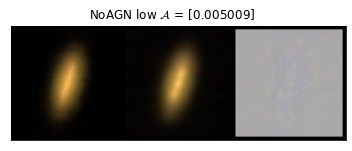

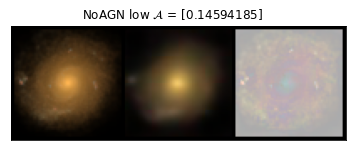

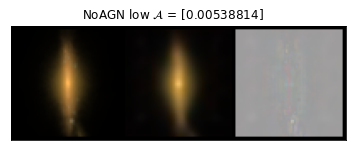

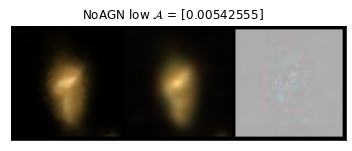

In [17]:
NoAGN_low_score=visualize_list(nihao_fn(NoAGN_low['galaxy'],bh=False),folder='data/SDSS/test/1.abnormal/',plot=3,plotname='NoAGN low',plotfeq=len(NoAGN_low)*20//3)

Setting up a new session...


   Loaded weights.


100%|██████████| 360/360 [00:03<00:00, 113.02it/s]


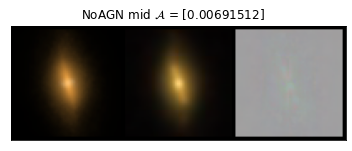

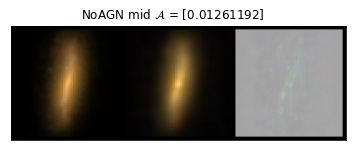

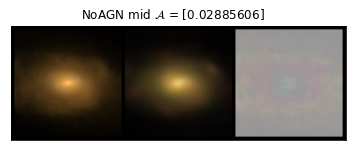

In [18]:
NoAGN_mid_score=visualize_list(nihao_fn(NoAGN_mid['galaxy'],bh=False),folder='data/SDSS/test/1.abnormal/',plot=3,plotname='NoAGN mid',plotfeq=len(NoAGN_mid)*20//3)

Setting up a new session...


   Loaded weights.


100%|██████████| 800/800 [00:06<00:00, 115.81it/s]


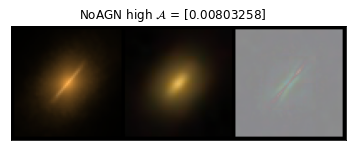

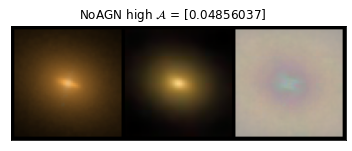

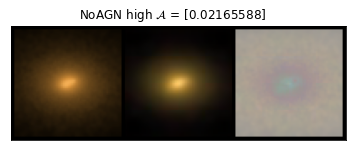

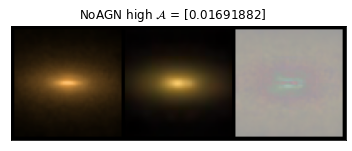

In [19]:
NoAGN_high_score=visualize_list(nihao_fn(NoAGN_high['galaxy'],bh=False),folder='data/SDSS/test/1.abnormal/',plot=3,plotname='NoAGN high',plotfeq=len(NoAGN_high)*20//3)

Setting up a new session...


   Loaded weights.


100%|██████████| 540/540 [00:04<00:00, 115.23it/s]


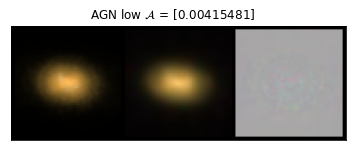

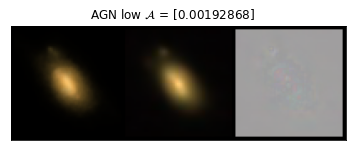

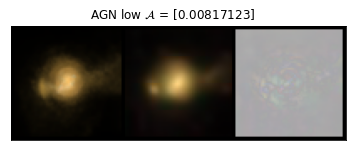

In [20]:
AGN_low_score=visualize_list(nihao_fn(AGN_low['galaxy'],bh=True),folder='data/SDSS/test/1.abnormal/',plot=3,plotname='AGN low',plotfeq=len(AGN_low)*20//3)

Setting up a new session...


   Loaded weights.


100%|██████████| 660/660 [00:05<00:00, 115.01it/s]


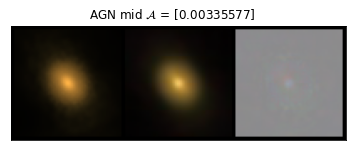

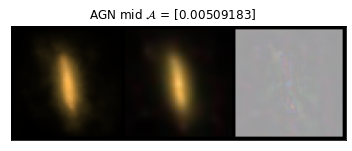

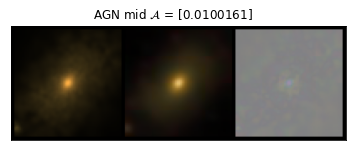

In [21]:
AGN_mid_score=visualize_list(nihao_fn(AGN_mid['galaxy'],bh=True),folder='data/SDSS/test/1.abnormal/',plot=3,plotname='AGN mid',plotfeq=len(AGN_mid)*20//3)

Setting up a new session...


   Loaded weights.


100%|██████████| 420/420 [00:03<00:00, 111.73it/s]


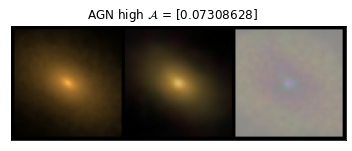

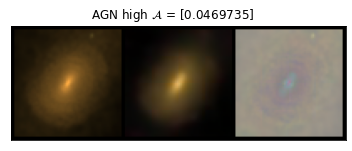

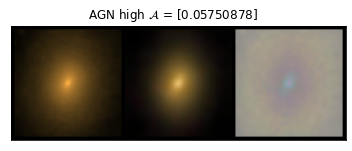

In [22]:
AGN_high_score=visualize_list(nihao_fn(AGN_high['galaxy'],bh=True),folder='data/SDSS/test/1.abnormal/',plot=3,plotname='AGN high',plotfeq=len(AGN_high)*20//3)

Setting up a new session...


   Loaded weights.


100%|██████████| 460/460 [00:04<00:00, 112.30it/s]


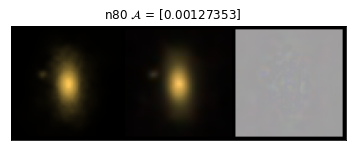

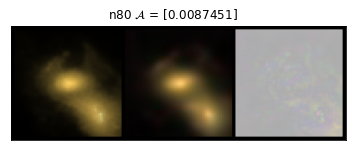

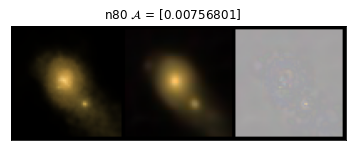

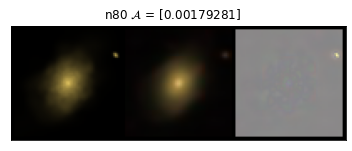

In [23]:
fn=np.array([os.path.basename(x) for x in glob.glob('data/n80_1129/*')])
fn.sort()
n80_score=visualize_list(fn,folder='data/n80_1129/',plot=3,plotname='n80',plotfeq=len(fn)//3)

Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 69.81it/s]


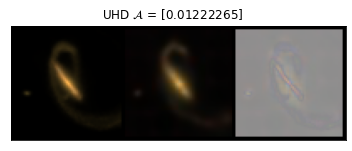

Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 70.90it/s]


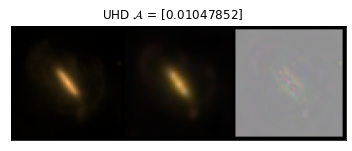

Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 70.45it/s]


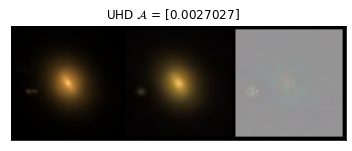

Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 75.74it/s]


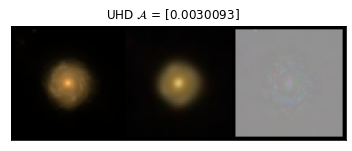

Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 60.52it/s]


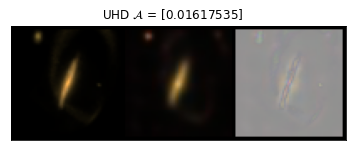

Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 70.25it/s]


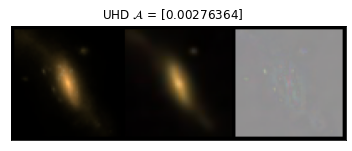

In [24]:
UHD_score=np.zeros((6,20))
for i,row in enumerate(t_nihao[t_nihao['score_faceon_UHD']!=0]):
    fn=np.array([os.path.basename(x) for x in glob.glob('data/UHD/UHD_'+row['galaxy'][1:]+'*')])
    fn.sort()
    UHD_score[i]=visualize_list(fn,folder='data/UHD/',plot=3,plotname='UHD',plotfeq=len(fn)//1)
    plt.show()

Setting up a new session...


   Loaded weights.


100%|██████████| 1/1 [00:00<00:00,  7.97it/s]


array([1.23040247])

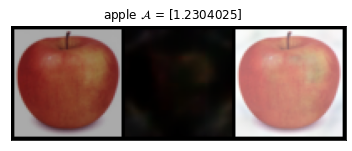

In [25]:
fn=['apple_fun.jpg']
visualize_list(fn,folder='data/fun/',plot=1,plotname='apple')

Setting up a new session...


   Loaded weights.


100%|██████████| 9/9 [00:00<00:00, 18.65it/s]


array([0.99999976, 0.99999976, 0.99999982, 1.        , 0.99999976,
       0.99999976, 0.99999994, 1.00000012, 0.87219787])

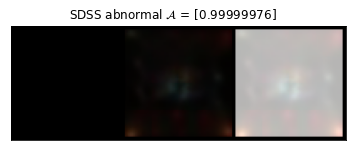

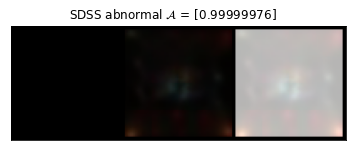

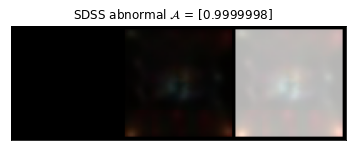

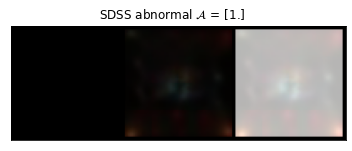

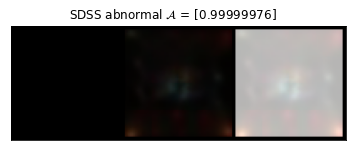

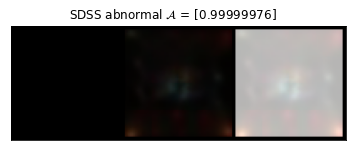

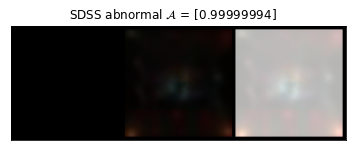

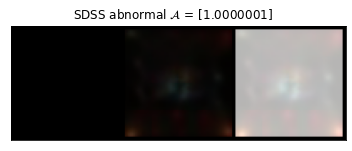

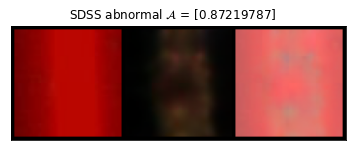

In [26]:
visualize_list(t_SDSS[t_SDSS['score']>0.75]['name'],folder='data/SDSS/test/0.normal/',plot=1,suffix='.png',plotname='SDSS abnormal')

In [27]:
NoAGN_score=np.hstack((NoAGN_low_score,NoAGN_mid_score,NoAGN_high_score))
AGN_score=np.hstack((AGN_low_score,AGN_mid_score,AGN_high_score))

In [28]:
def area(score1,score2,bins=np.linspace(0,0.02,100)):
    hist1,_=np.histogram(score1,density=True,bins=bins)
    hist2,_=np.histogram(score2,density=True,bins=bins)
    
    return np.min([hist1,hist2],axis=0).sum()/hist1.sum()

w/o  bh overlap: 0.7178895089580953
with bh overlap: 0.7107728872414784


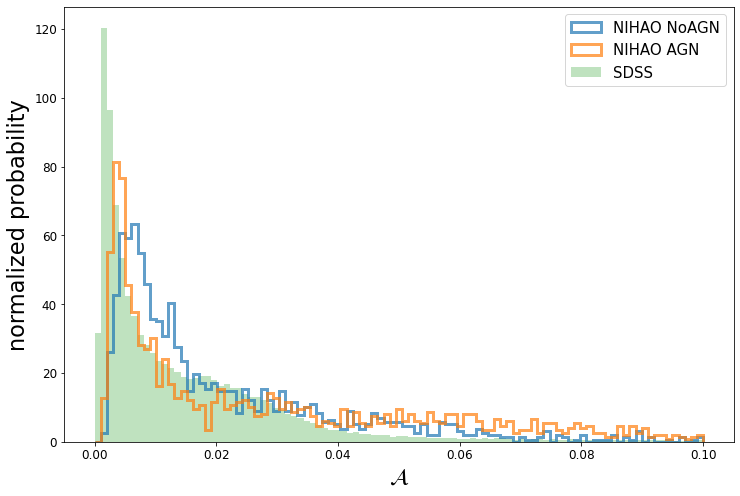

In [31]:
bins=np.linspace(0,0.1,100)
plt.figure(figsize=(12,8))
plt.hist(NoAGN_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO NoAGN')
plt.hist(AGN_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO AGN')
plt.hist(t_SDSS['score'],density=True,bins=bins,lw=3,alpha=0.3,label='SDSS')
plt.legend(fontsize=fontsize)
plt.xlabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.ylabel('normalized probability',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8)

print('w/o  bh overlap:',area(NoAGN_score,t_SDSS['score'],bins=bins))
print('with bh overlap:',area(AGN_score,t_SDSS['score'],bins=bins))

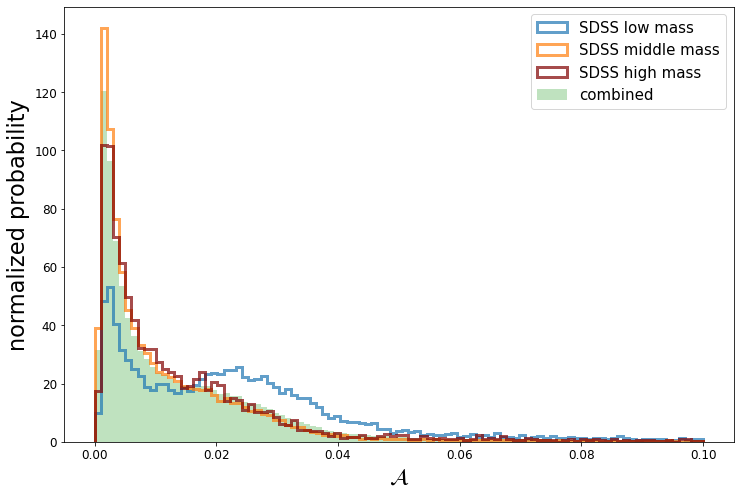

In [32]:
bins=np.linspace(0,0.1,100)
plt.figure(figsize=(12,8))
plt.hist(SDSS_low['score'],density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='SDSS low mass')
plt.hist(SDSS_mid['score'],density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='SDSS middle mass')
plt.hist(SDSS_high['score'],density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='SDSS high mass',color='maroon')
plt.hist(t_SDSS['score'],density=True,bins=bins,lw=3,alpha=0.3,label='combined',color='#2ca02c')
plt.legend(fontsize=fontsize)
plt.xlabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.ylabel('normalized probability',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

w/o  bh overlap: 0.47803258105935637
with bh overlap: 0.5503587174430292


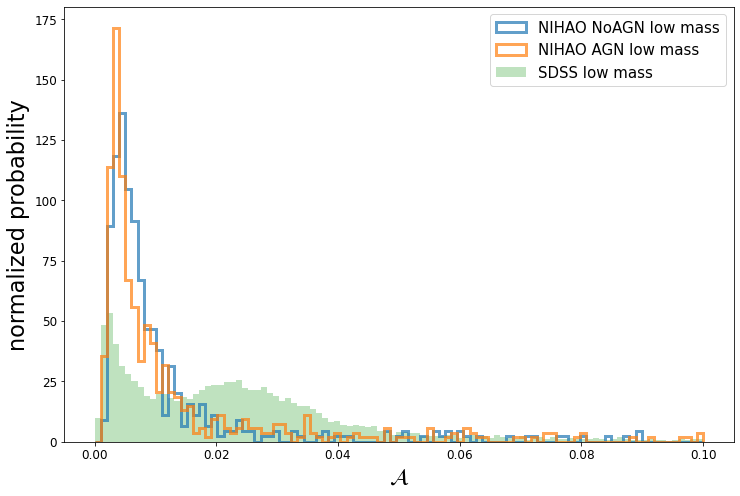

In [33]:
bins=np.linspace(0,0.1,100)
plt.figure(figsize=(12,8))
plt.hist(NoAGN_low_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO NoAGN low mass')
plt.hist(AGN_low_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO AGN low mass')
plt.hist(SDSS_low['score'],density=True,bins=bins,lw=3,alpha=0.3,label='SDSS low mass')
plt.legend(fontsize=fontsize)
plt.xlabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.ylabel('normalized probability',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

print('w/o  bh overlap:',area(NoAGN_low_score,SDSS_low['score'],bins=bins))
print('with bh overlap:',area(AGN_low_score,SDSS_low['score'],bins=bins))

w/o  bh overlap: 0.5509295079682679
with bh overlap: 0.5861020057628105


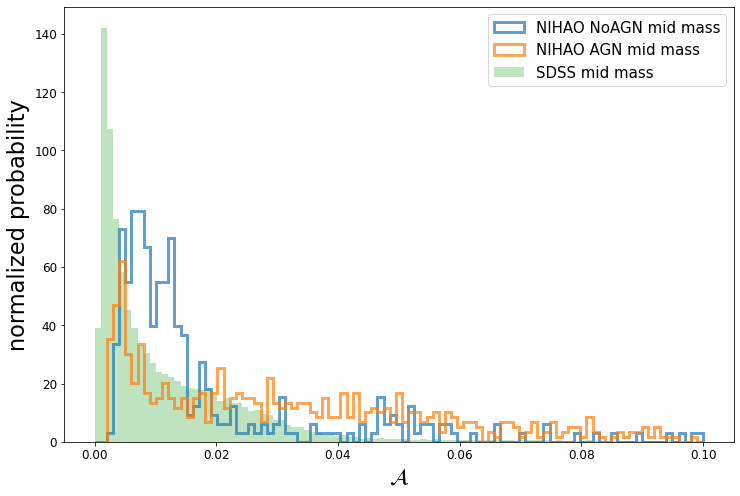

In [34]:
bins=np.linspace(0,0.1,100)
plt.figure(figsize=(12,8))
plt.hist(NoAGN_mid_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO NoAGN mid mass')
plt.hist(AGN_mid_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO AGN mid mass')
plt.hist(SDSS_mid['score'],density=True,bins=bins,lw=3,alpha=0.3,label='SDSS mid mass')
plt.legend(fontsize=fontsize)
plt.xlabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.ylabel('normalized probability',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

print('w/o  bh overlap:',area(NoAGN_mid_score,SDSS_mid['score'],bins=bins))
print('with bh overlap:',area(AGN_mid_score,SDSS_mid['score'],bins=bins))

w/o  bh overlap: 0.6121109343225126
with bh overlap: 0.4779118485000837


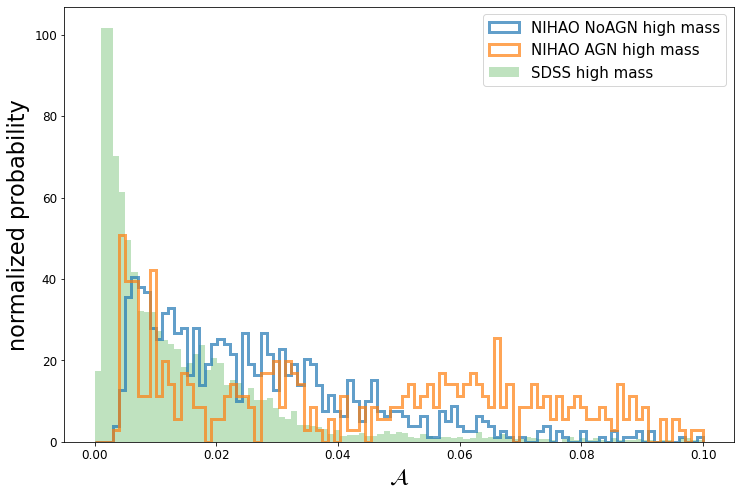

In [35]:
bins=np.linspace(0,0.1,100)
plt.figure(figsize=(12,8))
plt.hist(NoAGN_high_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO NoAGN high mass')
plt.hist(AGN_high_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO AGN high mass')
plt.hist(SDSS_high['score'],density=True,bins=bins,lw=3,alpha=0.3,label='SDSS high mass')
plt.legend(fontsize=fontsize)
plt.xlabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.ylabel('normalized probability',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

print('w/o  bh overlap:',area(NoAGN_high_score,SDSS_high['score'],bins=bins))
print('with bh overlap:',area(AGN_high_score,SDSS_high['score'],bins=bins))

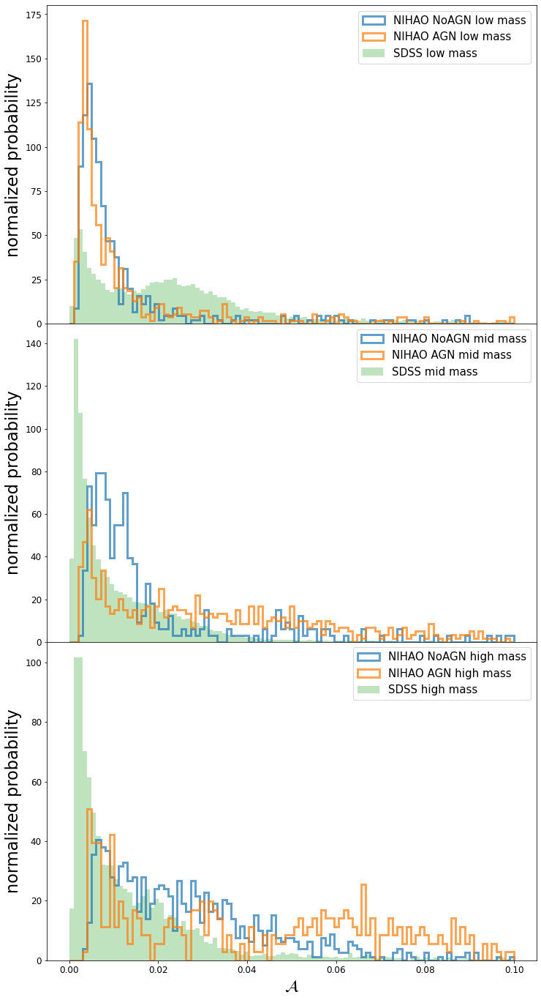

In [36]:
fig, axs = plt.subplots(3, 1, sharex=True,figsize=(12,24))
fig.subplots_adjust(hspace=0)

bins=np.linspace(0,0.1,100)
axs[0].hist(NoAGN_low_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO NoAGN low mass')
axs[0].hist(AGN_low_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO AGN low mass')
axs[0].hist(SDSS_low['score'],density=True,bins=bins,lw=3,alpha=0.3,label='SDSS low mass')
axs[0].set_ylabel('normalized probability',fontsize=fontsize*1.5)
axs[0].tick_params(labelsize=fontsize*0.8)
#axs[0].xaxis.set_tick_params(direction='in',size=fontsize*0.8)
axs[0].legend(fontsize=fontsize)

axs[1].hist(NoAGN_mid_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO NoAGN mid mass')
axs[1].hist(AGN_mid_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO AGN mid mass')
axs[1].hist(SDSS_mid['score'],density=True,bins=bins,lw=3,alpha=0.3,label='SDSS mid mass')
axs[1].set_ylabel('normalized probability',fontsize=fontsize*1.5)
axs[1].tick_params(labelsize=fontsize*0.8)
axs[1].legend(fontsize=fontsize)

axs[2].hist(NoAGN_high_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO NoAGN high mass')
axs[2].hist(AGN_high_score,density=True,bins=bins,histtype='step',lw=3,alpha=0.7,label='NIHAO AGN high mass')
axs[2].hist(SDSS_high['score'],density=True,bins=bins,lw=3,alpha=0.3,label='SDSS high mass')
axs[2].set_xlabel('$\mathcal{A}$',fontsize=fontsize*1.5)
axs[2].set_ylabel('normalized probability',fontsize=fontsize*1.5)
axs[2].tick_params(labelsize=fontsize*0.8)
axs[2].legend(fontsize=fontsize)

In [38]:
t_n80=QTable.read('n80_stats_mod.ecsv')
t_n80.show_in_notebook()

idx,galaxy,star mass,width,nihao1_mass,nihao1_name,score
0,g1.37e11_n80.0_e0.13,798437699.3131847,28.0,2028122297.7647648,g1.37e11,0.0014402307948330416
1,g1.57e11_n80.0_e0.13,737407055.8190175,26.0,1176921830.8007576,g1.57e11,0.0019474860629998148
2,g1.59e11_n80.0_e0.13,384253727.6738658,46.0,692364210.9081868,g1.59e11,0.004630420362809673
3,g2.19e11_n80.0_e0.13,490851057.1096259,24.0,935796079.316961,g2.19e11,0.0030829613009700552
4,g2.57e11_n80.0_e0.13,2043485763.551318,24.0,10859397748.405645,g2.57e11,0.004154151363763958
5,g3.21e11_n80.0_e0.13,1857683046.5125399,20.0,3727224640.981376,g3.21e11,0.00240287845954299
6,g3.55e11_n80.0_e0.13,2094171468.2653537,24.0,3998825071.69969,g3.55e11,0.0012750208508805372
7,g3.71e11_n80.0_e0.13,1904959947.2746382,38.0,12661376120.84038,g3.71e11,0.010173390712589025
8,g5.55e11_n80.0_e0.13,3487577672.1724405,18.0,17329741309.91971,g5.55e11,0.004573298769537359
9,g6.37e10_n80.0_e0.13,141108328.7571005,24.0,227182860.38420072,g6.37e10,0.0031710833427496254


In [39]:
## keep only n80 e0.13
del t_n80[10],t_n80[13],t_n80[13],t_n80[14]

In [40]:
t_n80['score std']=0.
t_n80

galaxy,star mass,width,nihao1_mass,nihao1_name,score,score std
str30,float64,float64,float64,str8,float64,float64
g1.37e11_n80.0_e0.13,798437699.3131847,28.0,2028122297.7647648,g1.37e11,0.0014402307948330416,0.0
g1.57e11_n80.0_e0.13,737407055.8190175,26.0,1176921830.8007576,g1.57e11,0.0019474860629998148,0.0
g1.59e11_n80.0_e0.13,384253727.6738658,46.0,692364210.9081868,g1.59e11,0.004630420362809673,0.0
g2.19e11_n80.0_e0.13,490851057.1096259,24.0,935796079.316961,g2.19e11,0.0030829613009700552,0.0
g2.57e11_n80.0_e0.13,2043485763.551318,24.0,10859397748.405645,g2.57e11,0.004154151363763958,0.0
g3.21e11_n80.0_e0.13,1857683046.5125399,20.0,3727224640.981376,g3.21e11,0.00240287845954299,0.0
g3.55e11_n80.0_e0.13,2094171468.2653537,24.0,3998825071.69969,g3.55e11,0.0012750208508805372,0.0
g3.71e11_n80.0_e0.13,1904959947.2746382,38.0,12661376120.84038,g3.71e11,0.010173390712589025,0.0
g5.55e11_n80.0_e0.13,3487577672.1724405,18.0,17329741309.91971,g5.55e11,0.004573298769537359,0.0


In [41]:
for i,row in enumerate(t_n80):
    fn=[]
    for j in range(20):
        fn.append(row['galaxy']+'_'+str(j).zfill(2)+'.png')
    n80_score=visualize_list(fn,folder='data/n80_1129/',plot=0)
    mean=n80_score.mean()
    std=n80_score.std()
    row['score']=mean
    row['score std']=std

Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 75.28it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 75.36it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 81.83it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 83.65it/s] 
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 86.05it/s] 
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 77.70it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 81.88it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 84.92it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 81.13it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 81.87it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 79.79it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 80.85it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 83.15it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 84.08it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 78.69it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 86.96it/s] 


In [42]:
t_n80

galaxy,star mass,width,nihao1_mass,nihao1_name,score,score std
str30,float64,float64,float64,str8,float64,float64
g1.37e11_n80.0_e0.13,798437699.3131847,28.0,2028122297.7647648,g1.37e11,0.001440229674335569,0.00048179789878148463
g1.57e11_n80.0_e0.13,737407055.8190175,26.0,1176921830.8007576,g1.57e11,0.0019474853645078838,0.0003258767512763255
g1.59e11_n80.0_e0.13,384253727.6738658,46.0,692364210.9081868,g1.59e11,0.004630422365153208,0.0026441061218500923
g2.19e11_n80.0_e0.13,490851057.1096259,24.0,935796079.316961,g2.19e11,0.0030829601746518165,0.002851825436921039
g2.57e11_n80.0_e0.13,2043485763.551318,24.0,10859397748.405645,g2.57e11,0.00415415110765025,0.0010095217940155187
g3.21e11_n80.0_e0.13,1857683046.5125399,20.0,3727224640.981376,g3.21e11,0.0024028782499954104,0.0006856816428654713
g3.55e11_n80.0_e0.13,2094171468.2653537,24.0,3998825071.69969,g3.55e11,0.001275020549655892,0.0005959235517515622
g3.71e11_n80.0_e0.13,1904959947.2746382,38.0,12661376120.84038,g3.71e11,0.010173391038551926,0.0030457285410952343
g5.55e11_n80.0_e0.13,3487577672.1724405,18.0,17329741309.91971,g5.55e11,0.004573297296883538,0.0024119167217472415


In [43]:
t_nihao['n80_mass']=0.
t_nihao['n80_score_mean']=0.
t_nihao['n80_score_std']=0.

In [44]:
for row in t_nihao:
    dummy=t_n80[t_n80['nihao1_name']==row['galaxy']]
    if len(dummy)!=0:
        row['n80_mass']=dummy['star mass']
        row['n80_score_mean']=dummy['score']
        row['n80_score_std']=dummy['score std']

In [45]:
t_nihao

galaxy,score_faceon,score_faceon_bh,score_faceon_UHD,score_mean,score_std,score_mean_bh,score_std_bh,score_mean_UHD,h.star.mass,h.star.mass_bh,SFR100,SFR500,SFR100_bh,SFR500_bh,metals,metals_bh,age,age_bh,b_mag,b_mag_bh,v_mag,v_mag_bh,n80_mass,n80_score_mean,n80_score_std,score_std_UHD
,,,,,,,,,solMass,solMass,,,,,,,,,,,,,,,,
str8,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
g3.71e11,0.03306020423769951,0.0069971648044884205,0.0,0.01434901833999902,0.007597201917489011,0.011416169349104166,0.0021036903530820836,0.0,12661376120.84038,9969259669.596684,1.4770153600000002,1.503682176,0.08390776999999999,0.296888768,0.013416932698757811,0.010208827095979353,5.550261177232001,6.305252730779587,-3.375630387876314,-2.7743955973033825,-4.186141034179121,-3.6083894763334166,1904959947.2746382,0.010173391038551926,0.0030457285410952343,0.0
g2.41e11,0.09529270976781845,0.009335225448012352,0.0,0.030253719864413144,0.021625721303593363,0.006225674389861524,0.002127482592425603,0.0,4160421922.708444,3668808915.1685877,0.62138228,0.6592232960000001,0.52019496,0.467929568,0.005904594392889497,0.00515654087169858,5.46394843681154,6.044807251983352,-3.780037095682086,-3.646959523554705,-4.51561072408184,-4.403316072016224,0.0,0.0,0.0,0.0
g7.08e11,0.1603548526763916,0.014686575159430504,0.06636839359998703,0.04714165702462196,0.047148057647635744,0.0650335218757391,0.04031590749537248,0.007033851975575089,31257030023.158638,12204213870.907187,3.64729312,3.42724608,0.005277218124999999,0.001055443625,0.01836776838200638,0.008664307675344107,6.959389751582163,9.643117754186667,-5.1555162106278285,-4.973209672799148,-6.035799877712112,-5.858199926280112,11202354306.891275,0.004507838748395443,0.001675445478639329,0.0033159458186803686
g2.79e12,0.015655530616641045,0.01999048888683319,0.008008807897567749,0.08746322290971875,0.05001197380981362,0.04906193232163787,0.031406069696843675,0.006220282765571028,200599193463.98062,89319602580.30887,11.01275392,10.834819072,1.0300848,1.3832140800000001,0.03130709800399194,0.01580204078750926,7.345754475517153,9.669712920259323,-4.825166867803229,-4.1582218290878465,-5.769110241979762,-5.102992764616265,0.0,0.0,0.0,0.003422806201321164
g1.12e12,0.003552366979420185,0.003565188031643629,0.018276292830705643,0.0074651219416409734,0.0019137201835052141,0.0035354198305867614,0.0006510822347146183,0.0029569583712145686,79253146369.30202,27097965684.363148,4.2931568,4.899977216,0.0094989925,0.029552424,0.03312163923062207,0.014840189427265222,7.15013786014087,10.323985948559239,-4.828782665914481,-4.581773667760287,-5.77261222081475,-5.534557492868125,0.0,0.0,0.0,0.00044759780576540415
g8.13e11,0.012658985331654549,0.002527926117181778,0.0,0.012272479361854494,0.003579976935322764,0.003422375116497278,0.0006890277734162945,0.0,67190625070.14467,17895798765.01921,3.63152,3.8573685760000003,0.10237803,0.025119554000000002,0.03295623388656569,0.010623448745045127,8.17615351776133,11.42032169399566,-4.704978324790743,-4.692840477549799,-5.662874769024355,-5.623321036206535,47833543347.01937,0.00540131536545232,0.0013899702203274617,0.0
g1.37e11,0.014456519857048988,0.003030212363228202,0.0,0.005996576708275825,0.002708781293299436,0.002584994031349197,0.0009166356279691635,0.0,2028122297.7647648,2098434850.6420968,0.09498993,0.12311588000000001,0.12625326,0.11986721600000001,0.0053516477127490076,0.0058240528477939355,8.333966778678196,8.146280423975933,-3.2504641431255186,-3.249057451754816,-4.057646288685855,-4.057751974429886,798437699.3131847,0.001440229674335569,0.00048179789878148463,0.0
g5.36e11,0.00830831378698349,0.003524353727698326,0.0,0.006782233831472695,0.00119846638448727,0.004711824050173163,0.001609518265588703,0.0,12269191248.222801,9639720103.341452,3.80793472,4.60677888,3.7120928,3.615990784,0.006485638814262924,0.00510816547155275,4.496

In [9]:
#t_nihao.write('nihao_stats_0206.ecsv')
t_nihao=QTable.read('nihao_stats_0206.ecsv')

In [10]:
n80=t_nihao[t_nihao['n80_mass']!=0]

In [11]:
n80 ##some n80 runs' mother NIHAO1 are not in our mass bin of interest

galaxy,score_faceon,score_faceon_bh,score_faceon_UHD,score_mean,score_std,score_mean_bh,score_std_bh,score_mean_UHD,h.star.mass,h.star.mass_bh,SFR100,SFR500,SFR100_bh,SFR500_bh,metals,metals_bh,age,age_bh,b_mag,b_mag_bh,v_mag,v_mag_bh,n80_mass,n80_score_mean,n80_score_std,score_std_UHD
,,,,,,,,,solMass,solMass,,,,,,,,,,,,,,,,
str8,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
g3.71e11,0.03306020423769951,0.0069971648044884205,0.0,0.01434901833999902,0.007597201917489011,0.011416169349104166,0.0021036903530820836,0.0,12661376120.84038,9969259669.596684,1.4770153600000002,1.503682176,0.08390776999999999,0.296888768,0.013416932698757811,0.010208827095979353,5.550261177232001,6.305252730779587,-3.375630387876314,-2.7743955973033825,-4.186141034179121,-3.6083894763334166,1904959947.2746382,0.010173389152623714,0.0030457267531022706,0.0
g7.08e11,0.1603548526763916,0.014686575159430504,0.06636839359998703,0.04714165702462196,0.047148057647635744,0.0650335218757391,0.04031590749537248,0.007033851975575089,31257030023.158638,12204213870.907187,3.64729312,3.42724608,0.005277218124999999,0.001055443625,0.01836776838200638,0.008664307675344107,6.959389751582163,9.643117754186667,-5.1555162106278285,-4.973209672799148,-6.035799877712112,-5.858199926280112,11202354306.891275,0.004507839563302696,0.0016754456691832607,0.0033159458186803686
g8.13e11,0.012658985331654549,0.002527926117181778,0.0,0.012272479361854494,0.003579976935322764,0.003422375116497278,0.0006890277734162945,0.0,67190625070.14467,17895798765.01921,3.63152,3.8573685760000003,0.10237803,0.025119554000000002,0.03295623388656569,0.010623448745045127,8.17615351776133,11.42032169399566,-4.704978324790743,-4.692840477549799,-5.662874769024355,-5.623321036206535,47833543347.01937,0.005401315551716834,0.001389970738846416,0.0
g1.37e11,0.014456519857048988,0.003030212363228202,0.0,0.005996576708275825,0.002708781293299436,0.002584994031349197,0.0009166356279691635,0.0,2028122297.7647648,2098434850.6420968,0.09498993,0.12311588000000001,0.12625326,0.11986721600000001,0.0053516477127490076,0.0058240528477939355,8.333966778678196,8.146280423975933,-3.2504641431255186,-3.249057451754816,-4.057646288685855,-4.057751974429886,798437699.3131847,0.0014402301283553242,0.0004817982872424517,0.0
g8.26e11,0.05512898415327072,0.07406056672334671,0.1638098508119583,0.03296397477388382,0.01950798952627957,0.05698244133964181,0.029398337327187673,0.005760442197788507,47384279470.01599,26755577254.790684,2.0285312,2.10215936,0.0021108871875,0.0033774195,0.023003799402270774,0.014480010940324067,8.710515373502316,10.855402388698927,-4.708815973306773,-4.561860918132899,-5.659638133323969,-5.517326875018459,32419445937.160114,0.004737210110761225,0.0013875998956260922,0.003542604081769792
g8.06e11,0.006645101588219404,0.009423518553376198,0.0,0.007814660714939237,0.0014235880683882644,0.006065651954850182,0.003848306908882809,0.0,45025361712.739395,16081591097.932034,13.0868416,10.368698368,1.0480293600000001,0.5110405760000001,0.022605230310880794,0.007364614003010651,4.227827021395323,6.769726549103909,-5.792669532444759,-5.42656370478891,-6.583308276799634,-6.258002390634339,6868908777.470288,0.007713911135215312,0.008035731503502478,0.0
g8.28e11,0.0034996639005839825,0.0422159805893898,0.0,0.005780264385975897,0.00184628992114062,0.07566191041842103,0.03298616562524951,0.0,18837768782.173225,10947508972.721836,8.04758016,7.571879936,0.8675746400000001,0.475160768,0.00626019816874139,0.004056414890753082,4.487223657148617,6.649143754810606,-6.464433063915949,-5.8168762278545945,-7.127923006179751,-6.589642701821244,1904841545.8952713,0.010415190760977567,0.004368321433618191,0.0
g2.57e11,0.16333052515983582,0.041874077171087265,0.0,0.0539279910037294,0.06438482092937163,0.01708759486209601,0.016224870681319392,0.0,10859397748.405645,886204

In [12]:
#['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2','#7f7f7f', '#bcbd22', '#17becf']

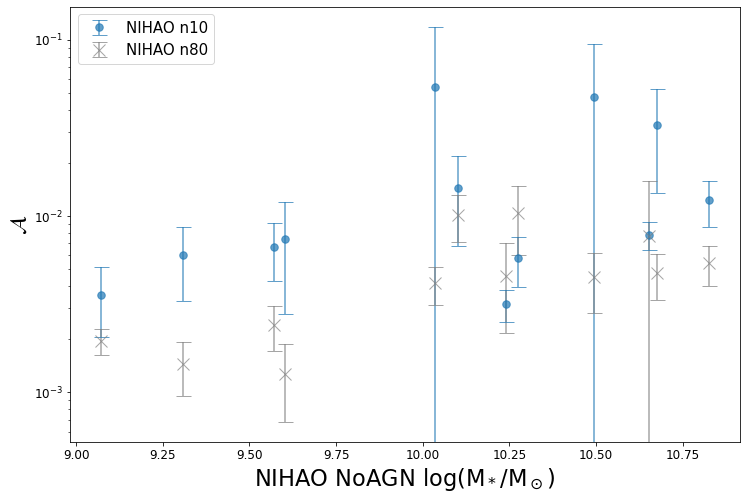

In [17]:
bins=np.linspace(0,0.1,100)
plt.figure(figsize=(12,8))
#plt.errorbar(np.log10(n80['n80_mass']),n80['n80_score_mean'],yerr=n80['n80_score_std'],fmt='.',capsize=3,label='NIHAO n80')
#plt.errorbar(np.log10(n80['h.star.mass'].value),n80['score_mean'],yerr=n80['score_std'],fmt='.',capsize=3,label='NIHAO NoAGN')
#plt.errorbar(np.log10(n80['h.star.mass_bh'].value),n80['score_mean_bh'],yerr=n80['score_std_bh'],fmt='.',capsize=3,label='NIHAO NoAGN')
plt.errorbar(np.log10(n80['h.star.mass'].value),n80['score_mean'],yerr=n80['score_std'],fmt='.',markersize=fontsize,capsize=fontsize/2,label='NIHAO n10',color='#1f77b4',alpha=0.7)
#plt.errorbar(np.log10(n80['h.star.mass'].value),n80['score_mean_bh'],yerr=n80['score_std_bh'],fmt='.',markersize=fontsize,capsize=fontsize/2,label='NIHAO AGN',color='#ff7f0e',alpha=0.7)
plt.errorbar(np.log10(n80['h.star.mass'].value),n80['n80_score_mean'],yerr=n80['n80_score_std'],fmt='x',markersize=fontsize/1.2,capsize=fontsize/2,label='NIHAO n80',color='#7f7f7f',alpha=0.7)
plt.yscale('log')
plt.xlabel('NIHAO NoAGN $\mathrm{log(M_*/M_\odot)}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.legend(fontsize=fontsize)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

In [51]:
t_nihao

galaxy,score_faceon,score_faceon_bh,score_faceon_UHD,score_mean,score_std,score_mean_bh,score_std_bh,score_mean_UHD,h.star.mass,h.star.mass_bh,SFR100,SFR500,SFR100_bh,SFR500_bh,metals,metals_bh,age,age_bh,b_mag,b_mag_bh,v_mag,v_mag_bh,n80_mass,n80_score_mean,n80_score_std,score_std_UHD
,,,,,,,,,solMass,solMass,,,,,,,,,,,,,,,,
str8,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
g3.71e11,0.03306020423769951,0.0069971648044884205,0.0,0.01434901833999902,0.007597201917489011,0.011416169349104166,0.0021036903530820836,0.0,12661376120.84038,9969259669.596684,1.4770153600000002,1.503682176,0.08390776999999999,0.296888768,0.013416932698757811,0.010208827095979353,5.550261177232001,6.305252730779587,-3.375630387876314,-2.7743955973033825,-4.186141034179121,-3.6083894763334166,1904959947.2746382,0.010173389152623714,0.0030457267531022706,0.0
g2.41e11,0.09529270976781845,0.009335225448012352,0.0,0.030253719864413144,0.021625721303593363,0.006225674389861524,0.002127482592425603,0.0,4160421922.708444,3668808915.1685877,0.62138228,0.6592232960000001,0.52019496,0.467929568,0.005904594392889497,0.00515654087169858,5.46394843681154,6.044807251983352,-3.780037095682086,-3.646959523554705,-4.51561072408184,-4.403316072016224,0.0,0.0,0.0,0.0
g7.08e11,0.1603548526763916,0.014686575159430504,0.06636839359998703,0.04714165702462196,0.047148057647635744,0.0650335218757391,0.04031590749537248,0.007033851975575089,31257030023.158638,12204213870.907187,3.64729312,3.42724608,0.005277218124999999,0.001055443625,0.01836776838200638,0.008664307675344107,6.959389751582163,9.643117754186667,-5.1555162106278285,-4.973209672799148,-6.035799877712112,-5.858199926280112,11202354306.891275,0.004507839563302696,0.0016754456691832607,0.0033159458186803686
g2.79e12,0.015655530616641045,0.01999048888683319,0.008008807897567749,0.08746322290971875,0.05001197380981362,0.04906193232163787,0.031406069696843675,0.006220282765571028,200599193463.98062,89319602580.30887,11.01275392,10.834819072,1.0300848,1.3832140800000001,0.03130709800399194,0.01580204078750926,7.345754475517153,9.669712920259323,-4.825166867803229,-4.1582218290878465,-5.769110241979762,-5.102992764616265,0.0,0.0,0.0,0.003422806201321164
g1.12e12,0.003552366979420185,0.003565188031643629,0.018276292830705643,0.0074651219416409734,0.0019137201835052141,0.0035354198305867614,0.0006510822347146183,0.0029569583712145686,79253146369.30202,27097965684.363148,4.2931568,4.899977216,0.0094989925,0.029552424,0.03312163923062207,0.014840189427265222,7.15013786014087,10.323985948559239,-4.828782665914481,-4.581773667760287,-5.77261222081475,-5.534557492868125,0.0,0.0,0.0,0.00044759780576540415
g8.13e11,0.012658985331654549,0.002527926117181778,0.0,0.012272479361854494,0.003579976935322764,0.003422375116497278,0.0006890277734162945,0.0,67190625070.14467,17895798765.01921,3.63152,3.8573685760000003,0.10237803,0.025119554000000002,0.03295623388656569,0.010623448745045127,8.17615351776133,11.42032169399566,-4.704978324790743,-4.692840477549799,-5.662874769024355,-5.623321036206535,47833543347.01937,0.005401315551716834,0.001389970738846416,0.0
g1.37e11,0.014456519857048988,0.003030212363228202,0.0,0.005996576708275825,0.002708781293299436,0.002584994031349197,0.0009166356279691635,0.0,2028122297.7647648,2098434850.6420968,0.09498993,0.12311588000000001,0.12625326,0.11986721600000001,0.0053516477127490076,0.0058240528477939355,8.333966778678196,8.146280423975933,-3.2504641431255186,-3.249057451754816,-4.057646288685855,-4.057751974429886,798437699.3131847,0.0014402301283553242,0.0004817982872424517,0.0
g5.36e11,0.00830831378698349,0.003524353727698326,0.0,0.006782233831472695,0.00119846638448727,0.004711824050173163,0.001609518265588703,0.0,12269191248.222801,9639720103.341452,3.80793472,4.60677888,3.7120928,3.615990784,0.006485638814262924,0.00510816547155275,4.49

In [52]:
t_nihao['score_std_UHD']=0.
for i,row in enumerate(t_nihao):
    if row['score_faceon_UHD']!=0:
        fn=np.array([os.path.basename(x) for x in glob.glob('data/UHD/UHD_'+row['galaxy'][1:]+'*')])
        fn.sort()
        UHD_score=visualize_list(fn,folder='data/UHD/',plot=0)
        row['score_mean_UHD']=UHD_score.mean()
        row['score_std_UHD']=UHD_score.std()

Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 74.46it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 78.97it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 80.91it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 85.41it/s] 
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 79.57it/s]
Setting up a new session...


   Loaded weights.


100%|██████████| 20/20 [00:00<00:00, 75.41it/s]


In [53]:
#t_nihao.write('nihao_stats_0206.ecsv',overwrite=True)
t_nihao

galaxy,score_faceon,score_faceon_bh,score_faceon_UHD,score_mean,score_std,score_mean_bh,score_std_bh,score_mean_UHD,h.star.mass,h.star.mass_bh,SFR100,SFR500,SFR100_bh,SFR500_bh,metals,metals_bh,age,age_bh,b_mag,b_mag_bh,v_mag,v_mag_bh,n80_mass,n80_score_mean,n80_score_std,score_std_UHD
,,,,,,,,,solMass,solMass,,,,,,,,,,,,,,,,
str8,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
g3.71e11,0.03306020423769951,0.0069971648044884205,0.0,0.01434901833999902,0.007597201917489011,0.011416169349104166,0.0021036903530820836,0.0,12661376120.84038,9969259669.596684,1.4770153600000002,1.503682176,0.08390776999999999,0.296888768,0.013416932698757811,0.010208827095979353,5.550261177232001,6.305252730779587,-3.375630387876314,-2.7743955973033825,-4.186141034179121,-3.6083894763334166,1904959947.2746382,0.010173389152623714,0.0030457267531022706,0.0
g2.41e11,0.09529270976781845,0.009335225448012352,0.0,0.030253719864413144,0.021625721303593363,0.006225674389861524,0.002127482592425603,0.0,4160421922.708444,3668808915.1685877,0.62138228,0.6592232960000001,0.52019496,0.467929568,0.005904594392889497,0.00515654087169858,5.46394843681154,6.044807251983352,-3.780037095682086,-3.646959523554705,-4.51561072408184,-4.403316072016224,0.0,0.0,0.0,0.0
g7.08e11,0.1603548526763916,0.014686575159430504,0.06636839359998703,0.04714165702462196,0.047148057647635744,0.0650335218757391,0.04031590749537248,0.007033850601874292,31257030023.158638,12204213870.907187,3.64729312,3.42724608,0.005277218124999999,0.001055443625,0.01836776838200638,0.008664307675344107,6.959389751582163,9.643117754186667,-5.1555162106278285,-4.973209672799148,-6.035799877712112,-5.858199926280112,11202354306.891275,0.004507839563302696,0.0016754456691832607,0.003315942300602455
g2.79e12,0.015655530616641045,0.01999048888683319,0.008008807897567749,0.08746322290971875,0.05001197380981362,0.04906193232163787,0.031406069696843675,0.006220284488517791,200599193463.98062,89319602580.30887,11.01275392,10.834819072,1.0300848,1.3832140800000001,0.03130709800399194,0.01580204078750926,7.345754475517153,9.669712920259323,-4.825166867803229,-4.1582218290878465,-5.769110241979762,-5.102992764616265,0.0,0.0,0.0,0.0034228069879050325
g1.12e12,0.003552366979420185,0.003565188031643629,0.018276292830705643,0.0074651219416409734,0.0019137201835052141,0.0035354198305867614,0.0006510822347146183,0.0029569587088190017,79253146369.30202,27097965684.363148,4.2931568,4.899977216,0.0094989925,0.029552424,0.03312163923062207,0.014840189427265222,7.15013786014087,10.323985948559239,-4.828782665914481,-4.581773667760287,-5.77261222081475,-5.534557492868125,0.0,0.0,0.0,0.0004475980342403278
g8.13e11,0.012658985331654549,0.002527926117181778,0.0,0.012272479361854494,0.003579976935322764,0.003422375116497278,0.0006890277734162945,0.0,67190625070.14467,17895798765.01921,3.63152,3.8573685760000003,0.10237803,0.025119554000000002,0.03295623388656569,0.010623448745045127,8.17615351776133,11.42032169399566,-4.704978324790743,-4.692840477549799,-5.662874769024355,-5.623321036206535,47833543347.01937,0.005401315551716834,0.001389970738846416,0.0
g1.37e11,0.014456519857048988,0.003030212363228202,0.0,0.005996576708275825,0.002708781293299436,0.002584994031349197,0.0009166356279691635,0.0,2028122297.7647648,2098434850.6420968,0.09498993,0.12311588000000001,0.12625326,0.11986721600000001,0.0053516477127490076,0.0058240528477939355,8.333966778678196,8.146280423975933,-3.2504641431255186,-3.249057451754816,-4.057646288685855,-4.057751974429886,798437699.3131847,0.0014402301283553242,0.0004817982872424517,0.0
g5.36e11,0.00830831378698349,0.003524353727698326,0.0,0.006782233831472695,0.00119846638448727,0.004711824050173163,0.001609518265588703,0.0,12269191248.222801,9639720103.341452,3.80793472,4.60677888,3.7120928,3.615990784,0.006485638814262924,0.00510816547155275,4.496

In [18]:
UHD=t_nihao[t_nihao['score_faceon_UHD']!=0]

In [19]:
UHD

galaxy,score_faceon,score_faceon_bh,score_faceon_UHD,score_mean,score_std,score_mean_bh,score_std_bh,score_mean_UHD,h.star.mass,h.star.mass_bh,SFR100,SFR500,SFR100_bh,SFR500_bh,metals,metals_bh,age,age_bh,b_mag,b_mag_bh,v_mag,v_mag_bh,n80_mass,n80_score_mean,n80_score_std,score_std_UHD
,,,,,,,,,solMass,solMass,,,,,,,,,,,,,,,,
str8,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
g7.08e11,0.1603548526763916,0.014686575159430504,0.06636839359998703,0.04714165702462196,0.047148057647635744,0.0650335218757391,0.04031590749537248,0.007033851975575089,31257030023.158638,12204213870.907187,3.64729312,3.42724608,0.005277218124999999,0.001055443625,0.01836776838200638,0.008664307675344107,6.959389751582163,9.643117754186667,-5.1555162106278285,-4.973209672799148,-6.035799877712112,-5.858199926280112,11202354306.891275,0.004507839563302696,0.0016754456691832607,0.0033159458186803686
g2.79e12,0.015655530616641045,0.01999048888683319,0.008008807897567749,0.08746322290971875,0.05001197380981362,0.04906193232163787,0.031406069696843675,0.006220282765571028,200599193463.98062,89319602580.30887,11.01275392,10.834819072,1.0300848,1.3832140800000001,0.03130709800399194,0.01580204078750926,7.345754475517153,9.669712920259323,-4.825166867803229,-4.1582218290878465,-5.769110241979762,-5.102992764616265,0.0,0.0,0.0,0.003422806201321164
g1.12e12,0.003552366979420185,0.003565188031643629,0.018276292830705643,0.0074651219416409734,0.0019137201835052141,0.0035354198305867614,0.0006510822347146183,0.0029569583712145686,79253146369.30202,27097965684.363148,4.2931568,4.899977216,0.0094989925,0.029552424,0.03312163923062207,0.014840189427265222,7.15013786014087,10.323985948559239,-4.828782665914481,-4.581773667760287,-5.77261222081475,-5.534557492868125,0.0,0.0,0.0,0.00044759780576540415
g7.55e11,0.07121222466230392,0.15813936293125153,0.10233621299266815,0.20835369378328322,0.032129212094935945,0.07202366904821247,0.061773079027974,0.0032381179393269123,31541718857.35806,20901795041.392082,2.90225536,3.0122145280000003,0.5868266799999999,0.360328448,0.01704245965063629,0.012603485320084044,6.5152832698115875,8.16670346151351,-5.223558190027628,-4.9686717965421945,-6.093381808074526,-5.865401140755053,0.0,0.0,0.0,0.0018013715452422409
g8.26e11,0.05512898415327072,0.07406056672334671,0.1638098508119583,0.03296397477388382,0.01950798952627957,0.05698244133964181,0.029398337327187673,0.005760442197788507,47384279470.01599,26755577254.790684,2.0285312,2.10215936,0.0021108871875,0.0033774195,0.023003799402270774,0.014480010940324067,8.710515373502316,10.855402388698927,-4.708815973306773,-4.561860918132899,-5.659638133323969,-5.517326875018459,32419445937.160114,0.004737210110761225,0.0013875998956260922,0.003542604081769792
g6.96e11,0.03351260721683502,0.020735284313559532,0.08812529593706131,0.01650900193490088,0.006457287861461536,0.036932973703369495,0.020955113623886648,0.00337038345169276,34010346184.53833,13195273055.772394,10.3221344,9.08231168,0.010554436249999999,0.054460896,0.015192734583808007,0.00558784571301928,3.958580894098388,6.56977346536826,-6.115857967959088,-5.628065616092286,-6.845587020011388,-6.435871692263513,0.0,0.0,0.0,0.0009318384777332334


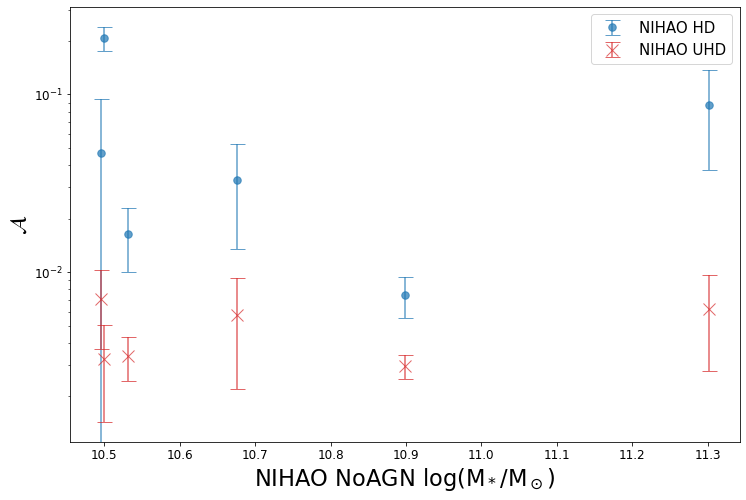

In [22]:
bins=np.linspace(0,0.1,100)
plt.figure(figsize=(12,8))
plt.errorbar(np.log10(UHD['h.star.mass'].value),UHD['score_mean'],yerr=UHD['score_std'],fmt='.',markersize=fontsize,capsize=fontsize/2,label='NIHAO HD',color='#1f77b4',alpha=0.7)
plt.errorbar(np.log10(UHD['h.star.mass'].value),UHD['score_mean_UHD'],yerr=UHD['score_std_UHD'],fmt='x',markersize=fontsize/1.2,capsize=fontsize/2,label='NIHAO UHD',color='#d62728',alpha=0.7)
plt.yscale('log')
plt.xlabel('NIHAO NoAGN $\mathrm{log(M_*/M_\odot)}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.legend(fontsize=fontsize)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

In [23]:
t_SDSS=QTable.read('t_SDSS.ecsv')
#['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2','#7f7f7f', '#bcbd22', '#17becf']

In [24]:
UHD

galaxy,score_faceon,score_faceon_bh,score_faceon_UHD,score_mean,score_std,score_mean_bh,score_std_bh,score_mean_UHD,h.star.mass,h.star.mass_bh,SFR100,SFR500,SFR100_bh,SFR500_bh,metals,metals_bh,age,age_bh,b_mag,b_mag_bh,v_mag,v_mag_bh,n80_mass,n80_score_mean,n80_score_std,score_std_UHD
,,,,,,,,,solMass,solMass,,,,,,,,,,,,,,,,
str8,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
g7.08e11,0.1603548526763916,0.014686575159430504,0.06636839359998703,0.04714165702462196,0.047148057647635744,0.0650335218757391,0.04031590749537248,0.007033851975575089,31257030023.158638,12204213870.907187,3.64729312,3.42724608,0.005277218124999999,0.001055443625,0.01836776838200638,0.008664307675344107,6.959389751582163,9.643117754186667,-5.1555162106278285,-4.973209672799148,-6.035799877712112,-5.858199926280112,11202354306.891275,0.004507839563302696,0.0016754456691832607,0.0033159458186803686
g2.79e12,0.015655530616641045,0.01999048888683319,0.008008807897567749,0.08746322290971875,0.05001197380981362,0.04906193232163787,0.031406069696843675,0.006220282765571028,200599193463.98062,89319602580.30887,11.01275392,10.834819072,1.0300848,1.3832140800000001,0.03130709800399194,0.01580204078750926,7.345754475517153,9.669712920259323,-4.825166867803229,-4.1582218290878465,-5.769110241979762,-5.102992764616265,0.0,0.0,0.0,0.003422806201321164
g1.12e12,0.003552366979420185,0.003565188031643629,0.018276292830705643,0.0074651219416409734,0.0019137201835052141,0.0035354198305867614,0.0006510822347146183,0.0029569583712145686,79253146369.30202,27097965684.363148,4.2931568,4.899977216,0.0094989925,0.029552424,0.03312163923062207,0.014840189427265222,7.15013786014087,10.323985948559239,-4.828782665914481,-4.581773667760287,-5.77261222081475,-5.534557492868125,0.0,0.0,0.0,0.00044759780576540415
g7.55e11,0.07121222466230392,0.15813936293125153,0.10233621299266815,0.20835369378328322,0.032129212094935945,0.07202366904821247,0.061773079027974,0.0032381179393269123,31541718857.35806,20901795041.392082,2.90225536,3.0122145280000003,0.5868266799999999,0.360328448,0.01704245965063629,0.012603485320084044,6.5152832698115875,8.16670346151351,-5.223558190027628,-4.9686717965421945,-6.093381808074526,-5.865401140755053,0.0,0.0,0.0,0.0018013715452422409
g8.26e11,0.05512898415327072,0.07406056672334671,0.1638098508119583,0.03296397477388382,0.01950798952627957,0.05698244133964181,0.029398337327187673,0.005760442197788507,47384279470.01599,26755577254.790684,2.0285312,2.10215936,0.0021108871875,0.0033774195,0.023003799402270774,0.014480010940324067,8.710515373502316,10.855402388698927,-4.708815973306773,-4.561860918132899,-5.659638133323969,-5.517326875018459,32419445937.160114,0.004737210110761225,0.0013875998956260922,0.003542604081769792
g6.96e11,0.03351260721683502,0.020735284313559532,0.08812529593706131,0.01650900193490088,0.006457287861461536,0.036932973703369495,0.020955113623886648,0.00337038345169276,34010346184.53833,13195273055.772394,10.3221344,9.08231168,0.010554436249999999,0.054460896,0.015192734583808007,0.00558784571301928,3.958580894098388,6.56977346536826,-6.115857967959088,-5.628065616092286,-6.845587020011388,-6.435871692263513,0.0,0.0,0.0,0.0009318384777332334


In [25]:
color_scheme={'SDSS':'#2ca02c','NIHAO NoAGN':'#1f77b4','NIHAO AGN':'#ff7f0e','NIHAO n80':'#7f7f7f','NIHAO UHD':'#d62728'}

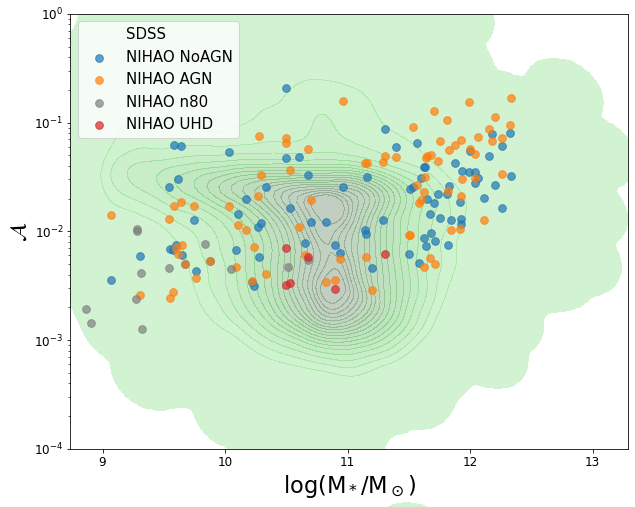

In [26]:
plt.figure(figsize=(10,8))
sns.kdeplot(x=np.log10(t_SDSS['m']),y=t_SDSS['score'],log_scale=(False,True),label='SDSS',fill=True,levels=20,thresh=1e-7,color='#2ca02c',alpha=0.3)
plt.scatter(np.log10(t_nihao['h.star.mass'].value),t_nihao['score_mean'],label='NIHAO NoAGN',s=fontsize*4,c='#1f77b4',alpha=0.7)
plt.scatter(np.log10(t_nihao['h.star.mass'].value),t_nihao['score_mean_bh'],label='NIHAO AGN',s=fontsize*4,c='#ff7f0e',alpha=0.7)
plt.scatter(np.log10(n80['n80_mass']),n80['n80_score_mean'],label='NIHAO n80',s=fontsize*4,c='#7f7f7f',alpha=0.7)
plt.scatter(np.log10(UHD['h.star.mass'].value),UHD['score_mean_UHD'],label='NIHAO UHD',s=fontsize*4,c='#d62728',alpha=0.7)
plt.ylim(1e-4,1)
plt.xlabel('$\mathrm{log(M_*/M_\odot)}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.legend(fontsize=fontsize)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

In [61]:
UHD[UHD['n80_mass']!=0]

galaxy,score_faceon,score_faceon_bh,score_faceon_UHD,score_mean,score_std,score_mean_bh,score_std_bh,score_mean_UHD,h.star.mass,h.star.mass_bh,SFR100,SFR500,SFR100_bh,SFR500_bh,metals,metals_bh,age,age_bh,b_mag,b_mag_bh,v_mag,v_mag_bh,n80_mass,n80_score_mean,n80_score_std,score_std_UHD
,,,,,,,,,solMass,solMass,,,,,,,,,,,,,,,,
str8,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
g7.08e11,0.1603548526763916,0.014686575159430504,0.06636839359998703,0.04714165702462196,0.047148057647635744,0.0650335218757391,0.04031590749537248,0.007033850601874292,31257030023.158638,12204213870.907187,3.64729312,3.42724608,0.005277218124999999,0.001055443625,0.01836776838200638,0.008664307675344107,6.959389751582163,9.643117754186667,-5.1555162106278285,-4.973209672799148,-6.035799877712112,-5.858199926280112,11202354306.891275,0.004507839563302696,0.0016754456691832607,0.003315942300602455
g8.26e11,0.05512898415327072,0.07406056672334671,0.1638098508119583,0.03296397477388382,0.01950798952627957,0.05698244133964181,0.029398337327187673,0.005760439345613122,47384279470.01599,26755577254.790684,2.0285312,2.10215936,0.0021108871875,0.0033774195,0.023003799402270774,0.014480010940324067,8.710515373502316,10.855402388698927,-4.708815973306773,-4.561860918132899,-5.659638133323969,-5.517326875018459,32419445937.160114,0.004737210110761225,0.0013875998956260922,0.00354260153715374


In [62]:
#fn=np.array([os.path.basename(x) for x in glob.glob('data/SDSS/test/0.normal/*')])
#fn
np.array([os.path.basename(x) for x in glob.glob('data/faceon/*g7.08e11*')])

array(['classic_faceon_g7.08e11.png', 'bh_faceon_g7.08e11.png',
       'n80_faceon_g7.08e11_n80.0_e0.10.png',
       'n80_faceon_g7.08e11_n80.0_e0.13.png', 'UHD_faceon_g7.08e11.png'],
      dtype='<U35')

Setting up a new session...


   Loaded weights.


100%|██████████| 1/1 [00:00<00:00,  6.88it/s]


array([0.16035487])

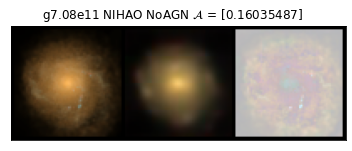

In [63]:
visualize_list(['classic_faceon_g7.08e11.png'],folder='data/faceon/',plot=1,plotname='g7.08e11 NIHAO NoAGN')

Setting up a new session...


   Loaded weights.


100%|██████████| 1/1 [00:00<00:00,  6.93it/s]


array([0.01468659])

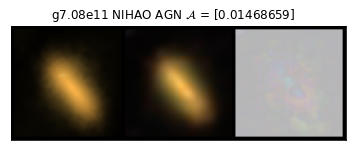

In [64]:
visualize_list(['bh_faceon_g7.08e11.png'],folder='data/faceon/',plot=1,plotname='g7.08e11 NIHAO AGN')

Setting up a new session...


   Loaded weights.


100%|██████████| 1/1 [00:00<00:00,  7.58it/s]


array([0.00756577])

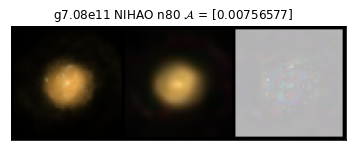

In [65]:
visualize_list(['n80_faceon_g7.08e11_n80.0_e0.13.png'],folder='data/faceon/',plot=1,plotname='g7.08e11 NIHAO n80')

Setting up a new session...


   Loaded weights.


100%|██████████| 1/1 [00:00<00:00,  6.66it/s]


array([0.06636836])

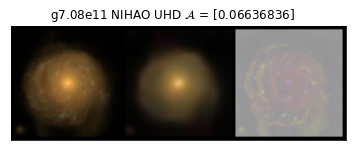

In [66]:
visualize_list(['UHD_faceon_g7.08e11.png'],folder='data/faceon/',plot=1,plotname='g7.08e11 NIHAO UHD')

In [67]:
np.array([os.path.basename(x) for x in glob.glob('data/faceon/*g8.26e11*')])

array(['n80_faceon_g8.26e11_n80.0_e0.10_CStar0.13.png',
       'n80_faceon_g8.26e11_n80.0_e0.10.png', 'bh_faceon_g8.26e11.png',
       'n80_faceon_g8.26e11_n80.0_e0.13.png',
       'classic_faceon_g8.26e11.png', 'UHD_faceon_g8.26e11.png',
       'n80_faceon_g8.26e11_n80.0_e0.13_Cstar0.13.png'], dtype='<U45')

Setting up a new session...


   Loaded weights.


100%|██████████| 1/1 [00:00<00:00,  6.73it/s]


array([0.055129])

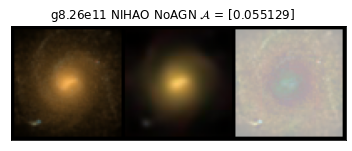

In [68]:
visualize_list(['classic_faceon_g8.26e11.png'],folder='data/faceon/',plot=1,plotname='g8.26e11 NIHAO NoAGN')

Setting up a new session...


   Loaded weights.


100%|██████████| 1/1 [00:00<00:00,  6.57it/s]


array([0.07406052])

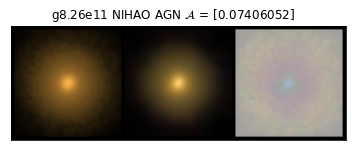

In [69]:
visualize_list(['bh_faceon_g8.26e11.png'],folder='data/faceon/',plot=1,plotname='g8.26e11 NIHAO AGN')

Setting up a new session...


   Loaded weights.


100%|██████████| 1/1 [00:00<00:00,  7.91it/s]


array([0.01302686])

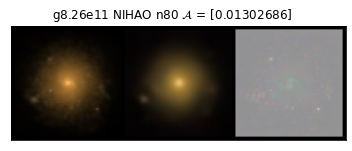

In [70]:
visualize_list(['n80_faceon_g8.26e11_n80.0_e0.13.png'],folder='data/faceon/',plot=1,plotname='g8.26e11 NIHAO n80')

Setting up a new session...


   Loaded weights.


100%|██████████| 1/1 [00:00<00:00,  6.60it/s]


array([0.01011122])

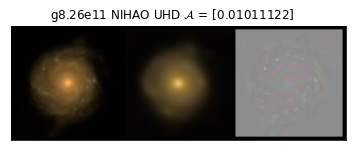

In [71]:
visualize_list(['UHD_faceon_g8.26e11.png'],folder='data/faceon/',plot=1,plotname='g8.26e11 NIHAO UHD')

In [27]:
def scatter_hist(x, y, yerr, color, alpha, fontsize, label, ax, ax_histx, ax_histy, bins=25):
    # no labels
    ax_histx.tick_params(axis="x", labelbottom=False)
    ax_histy.tick_params(axis="y", labelleft=False)

    # the scatter plot:
    ax.errorbar(x,y,yerr=yerr,fmt='.',color=color,capsize=fontsize/2,markersize=fontsize,alpha=alpha,label=label)

    # x,y hist
    xx=x[np.isinf(x)==False]
    yy=y[np.isinf(y)==False]
    ax_histx.hist(xx, histtype='step',density=1, color=color,bins=bins,lw=2,alpha=alpha)
    ax_histy.hist(yy, histtype='step',density=1, color=color,bins=bins,lw=2,alpha=alpha,orientation='horizontal')

#['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2','#7f7f7f', '#bcbd22', '#17becf']

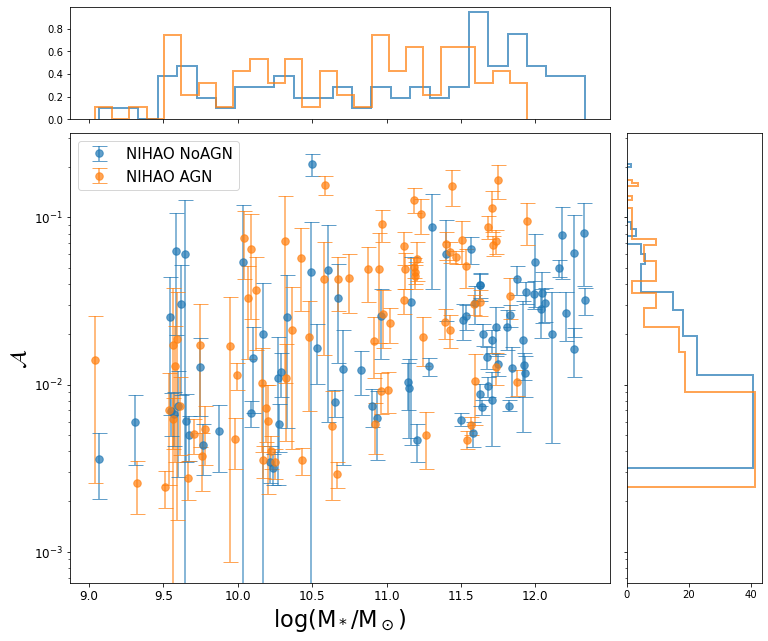

In [28]:
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.set_yscale('log')


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.

# scatter_hist(x, y, yerr, color, alpha, fontsize, label, ax, ax_histx, ax_histy, bins=25)
scatter_hist(np.log10(t_nihao['h.star.mass'].value), t_nihao['score_mean'],t_nihao['score_std'],'#1f77b4',0.7,fontsize,'NIHAO NoAGN'
             ,ax, ax_histx, ax_histy)
scatter_hist(np.log10(t_nihao['h.star.mass_bh'].value), t_nihao['score_mean_bh'],t_nihao['score_std_bh'],'#ff7f0e',0.7,fontsize,'NIHAO AGN'
             ,ax, ax_histx, ax_histy)

ax.set_xlabel('$\mathrm{log(M_*/M_\odot)}$',fontsize=fontsize*1.5)
ax.set_ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
ax.legend(fontsize=fontsize)
ax.tick_params(axis='both', labelsize=fontsize*0.8)

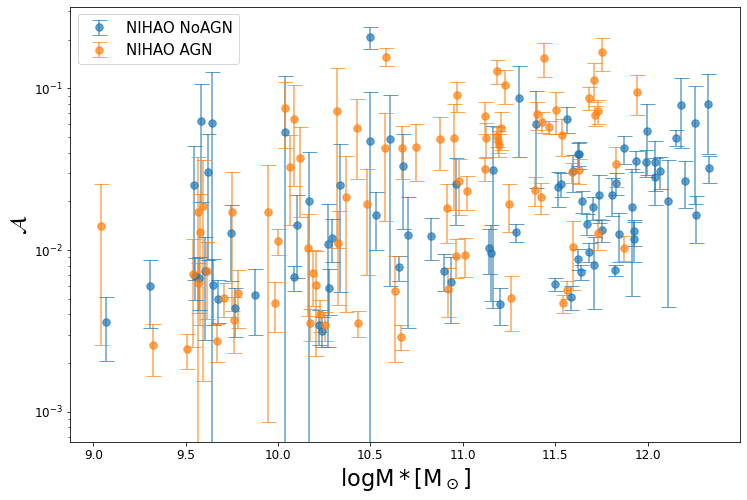

In [74]:
plt.figure(figsize=(12,8))
plt.errorbar(np.log10(t_nihao['h.star.mass'].value),t_nihao['score_mean'],yerr=t_nihao['score_std'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO NoAGN')
plt.errorbar(np.log10(t_nihao['h.star.mass_bh'].value),t_nihao['score_mean_bh'],yerr=t_nihao['score_std_bh'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO AGN')
#plt.xscale('log')
plt.yscale('log')
plt.xlabel('$\mathrm{logM*[M_\odot]}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.legend(fontsize=fontsize)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

<ipython-input-30-ed0f20f2686f>:21: RuntimeWarning: divide by zero encountered in log10
  scatter_hist(np.log10(t_nihao['SFR100_bh']), t_nihao['score_mean_bh'],t_nihao['score_std_bh'],'#ff7f0e',0.7,fontsize,'NIHAO AGN'


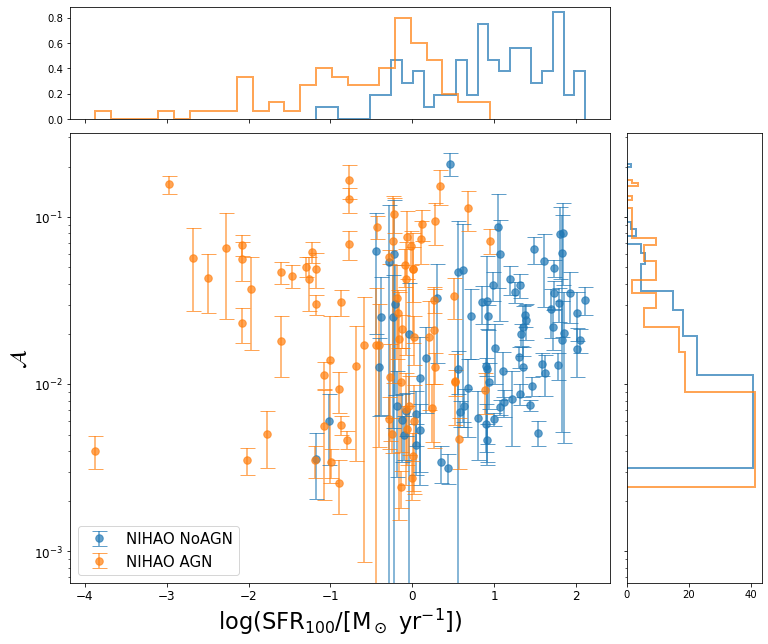

In [30]:
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.set_yscale('log')


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.

# scatter_hist(x, y, yerr, color, alpha, fontsize, label, ax, ax_histx, ax_histy, bins=25)
scatter_hist(np.log10(t_nihao['SFR100']), t_nihao['score_mean'],t_nihao['score_std'],'#1f77b4',0.7,fontsize,'NIHAO NoAGN'
             ,ax, ax_histx, ax_histy)
scatter_hist(np.log10(t_nihao['SFR100_bh']), t_nihao['score_mean_bh'],t_nihao['score_std_bh'],'#ff7f0e',0.7,fontsize,'NIHAO AGN'
             ,ax, ax_histx, ax_histy)

ax.set_xlabel('$\mathrm{log(SFR_{100}/ [M_\odot\  yr^{-1}])}$',fontsize=fontsize*1.5)
ax.set_ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
ax.legend(fontsize=fontsize)
ax.tick_params(axis='both', labelsize=fontsize*0.8)

<ipython-input-76-4f0865e61e62>:3: RuntimeWarning: divide by zero encountered in log10
  plt.errorbar(np.log10(t_nihao['SFR100_bh']),t_nihao['score_mean_bh'],yerr=t_nihao['score_std_bh'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO AGN')


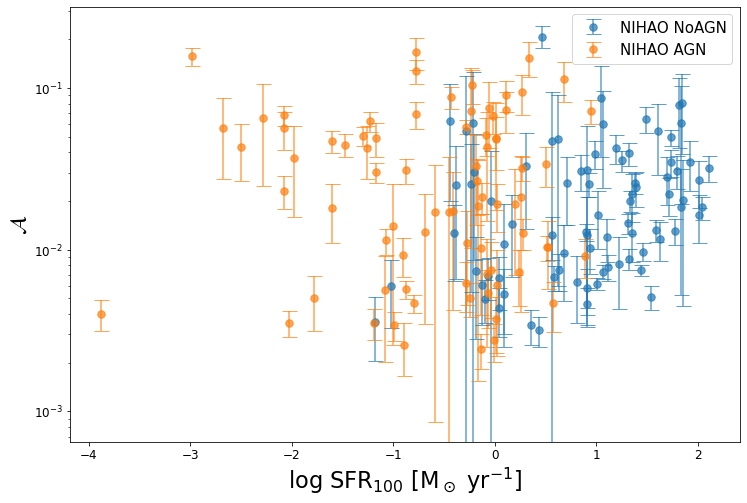

In [76]:
plt.figure(figsize=(12,8))
plt.errorbar(np.log10(t_nihao['SFR100']),t_nihao['score_mean'],yerr=t_nihao['score_std'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO NoAGN')
plt.errorbar(np.log10(t_nihao['SFR100_bh']),t_nihao['score_mean_bh'],yerr=t_nihao['score_std_bh'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO AGN')
plt.yscale('log')
plt.xlabel('$\mathrm{log\ SFR_{100}\ [M_\odot\  yr^{-1}]}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.legend(fontsize=fontsize)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

<ipython-input-31-9e698baeeda2>:21: RuntimeWarning: divide by zero encountered in log10
  scatter_hist(np.log10(t_nihao['SFR500_bh']), t_nihao['score_mean_bh'],t_nihao['score_std_bh'],'#ff7f0e',0.7,fontsize,'NIHAO AGN'


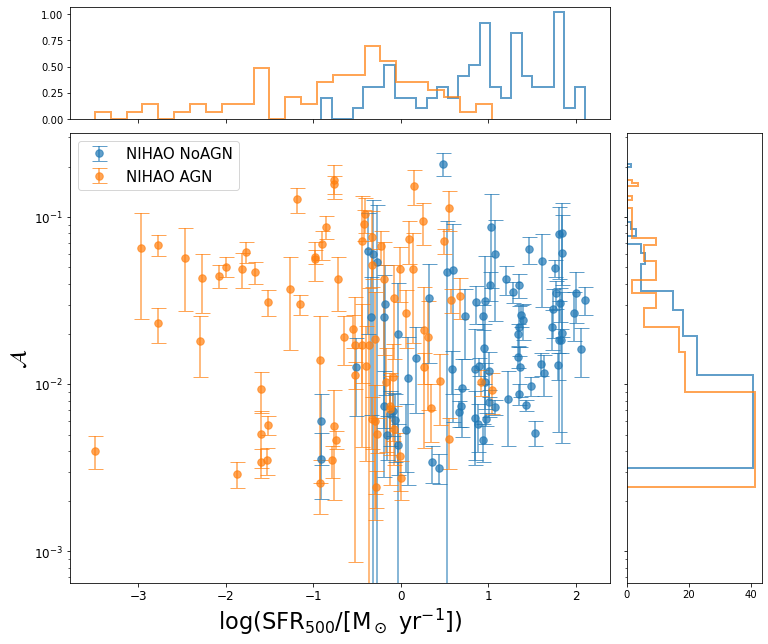

In [31]:
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.set_yscale('log')


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.

# scatter_hist(x, y, yerr, color, alpha, fontsize, label, ax, ax_histx, ax_histy, bins=25)
scatter_hist(np.log10(t_nihao['SFR500']), t_nihao['score_mean'],t_nihao['score_std'],'#1f77b4',0.7,fontsize,'NIHAO NoAGN'
             ,ax, ax_histx, ax_histy)
scatter_hist(np.log10(t_nihao['SFR500_bh']), t_nihao['score_mean_bh'],t_nihao['score_std_bh'],'#ff7f0e',0.7,fontsize,'NIHAO AGN'
             ,ax, ax_histx, ax_histy)

ax.set_xlabel('$\mathrm{log(SFR_{500}/ [M_\odot\  yr^{-1}])}$',fontsize=fontsize*1.5)
ax.set_ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
ax.legend(fontsize=fontsize)
ax.tick_params(axis='both', labelsize=fontsize*0.8)

<ipython-input-78-2d675f8e8cf8>:3: RuntimeWarning: divide by zero encountered in log10
  plt.errorbar(np.log10(t_nihao['SFR500_bh']),t_nihao['score_mean_bh'],yerr=t_nihao['score_std_bh'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO AGN')


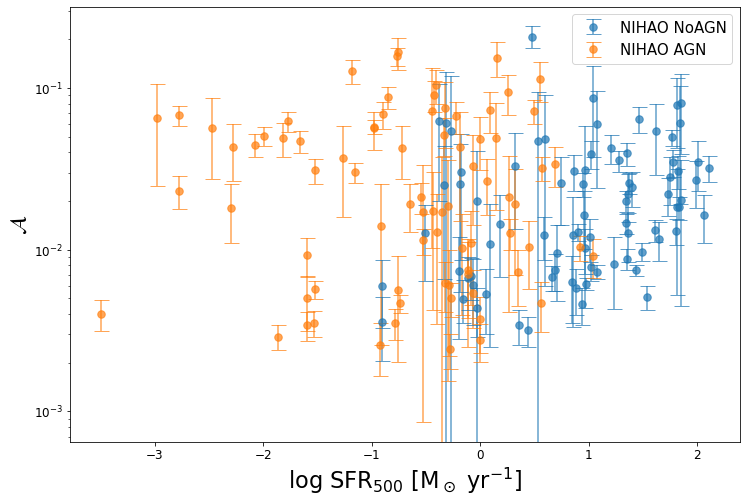

In [78]:
plt.figure(figsize=(12,8))
plt.errorbar(np.log10(t_nihao['SFR500']),t_nihao['score_mean'],yerr=t_nihao['score_std'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO NoAGN')
plt.errorbar(np.log10(t_nihao['SFR500_bh']),t_nihao['score_mean_bh'],yerr=t_nihao['score_std_bh'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO AGN')
plt.yscale('log')
plt.xlabel('$\mathrm{log\ SFR_{500}\ [M_\odot\  yr^{-1}]}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.legend(fontsize=fontsize)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

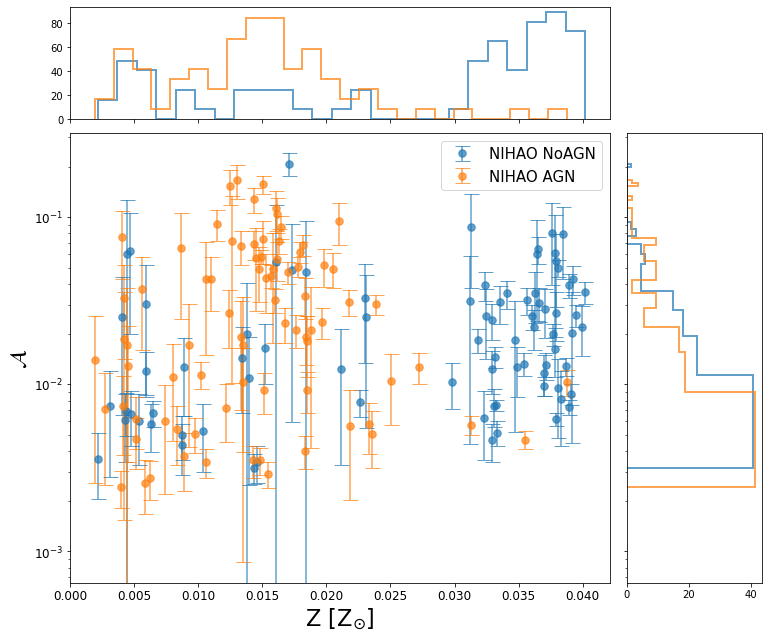

In [79]:
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.set_yscale('log')


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.

# scatter_hist(x, y, yerr, color, alpha, fontsize, label, ax, ax_histx, ax_histy, bins=25)
scatter_hist(t_nihao['metals'], t_nihao['score_mean'],t_nihao['score_std'],'#1f77b4',0.7,fontsize,'NIHAO NoAGN'
             ,ax, ax_histx, ax_histy)
scatter_hist(t_nihao['metals_bh'], t_nihao['score_mean_bh'],t_nihao['score_std_bh'],'#ff7f0e',0.7,fontsize,'NIHAO AGN'
             ,ax, ax_histx, ax_histy)

ax.set_xlabel('$\mathrm{Z\ [Z_{\odot}]}$',fontsize=fontsize*1.5)
ax.set_ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
ax.legend(fontsize=fontsize)
ax.tick_params(axis='both', labelsize=fontsize*0.8)

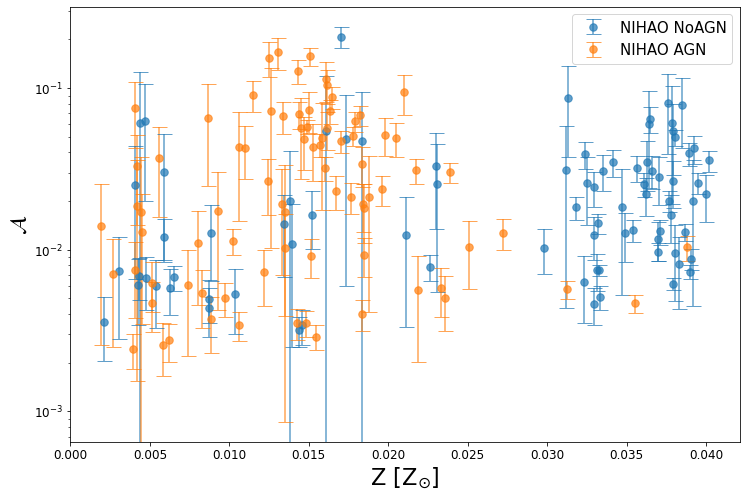

In [80]:
plt.figure(figsize=(12,8))
plt.errorbar(t_nihao['metals'],t_nihao['score_mean'],yerr=t_nihao['score_std'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO NoAGN')
plt.errorbar(t_nihao['metals_bh'],t_nihao['score_mean_bh'],yerr=t_nihao['score_std_bh'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO AGN')
plt.yscale('log')
plt.xlabel('$\mathrm{Z\ [Z_{\odot}]}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.legend(fontsize=fontsize)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

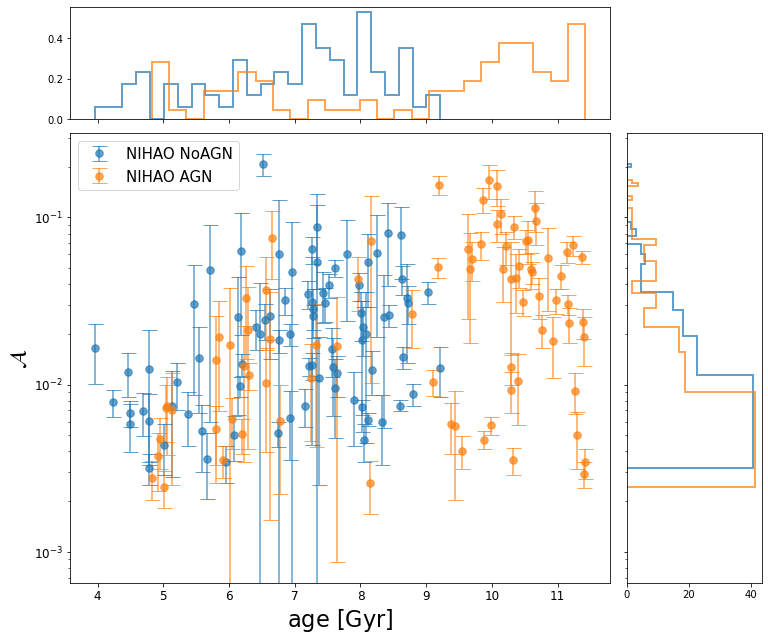

In [81]:
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.set_yscale('log')


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.

# scatter_hist(x, y, yerr, color, alpha, fontsize, label, ax, ax_histx, ax_histy, bins=25)
scatter_hist(t_nihao['age'], t_nihao['score_mean'],t_nihao['score_std'],'#1f77b4',0.7,fontsize,'NIHAO NoAGN'
             ,ax, ax_histx, ax_histy)
scatter_hist(t_nihao['age_bh'], t_nihao['score_mean_bh'],t_nihao['score_std_bh'],'#ff7f0e',0.7,fontsize,'NIHAO AGN'
             ,ax, ax_histx, ax_histy)

ax.set_xlabel('$\mathrm{age\ [Gyr]}$',fontsize=fontsize*1.5)
ax.set_ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
ax.legend(fontsize=fontsize)
ax.tick_params(axis='both', labelsize=fontsize*0.8)

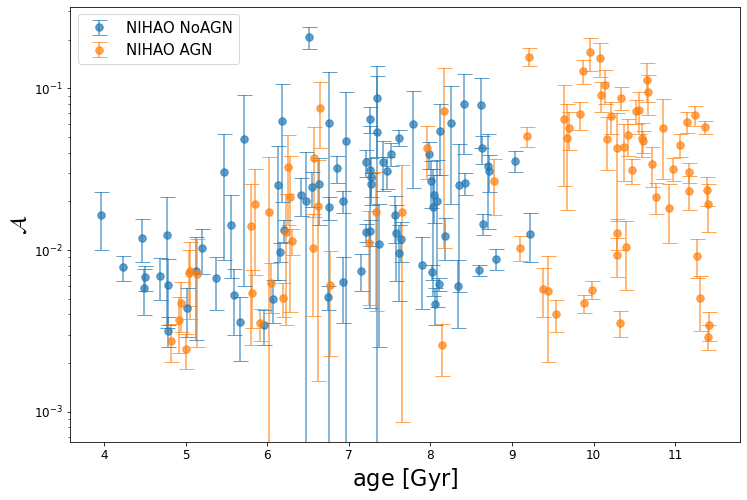

In [82]:
plt.figure(figsize=(12,8))
plt.errorbar(t_nihao['age'],t_nihao['score_mean'],yerr=t_nihao['score_std'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO NoAGN')
plt.errorbar(t_nihao['age_bh'],t_nihao['score_mean_bh'],yerr=t_nihao['score_std_bh'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO AGN')
plt.yscale('log')
plt.xlabel('$\mathrm{age\ [Gyr]}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.legend(fontsize=fontsize)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

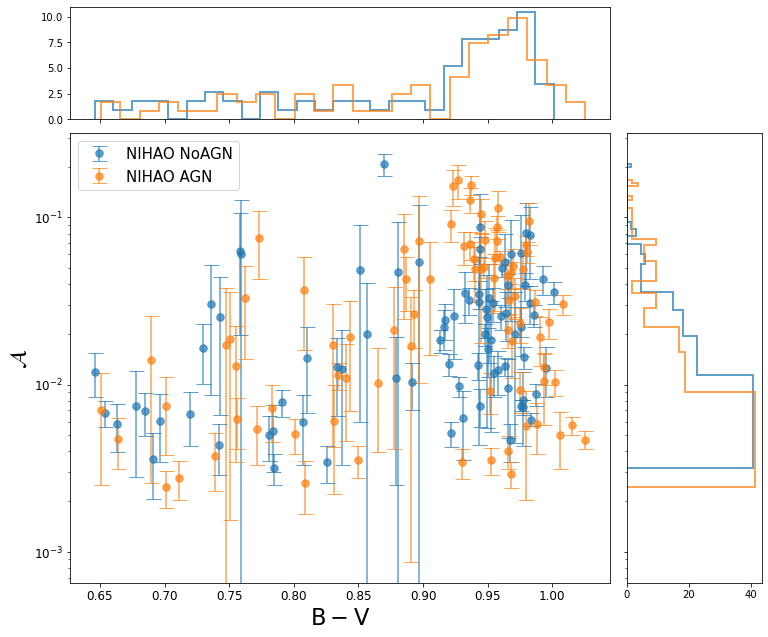

In [83]:
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.set_yscale('log')


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.

# scatter_hist(x, y, yerr, color, alpha, fontsize, label, ax, ax_histx, ax_histy, bins=25)
scatter_hist(t_nihao['b_mag']-t_nihao['v_mag'], t_nihao['score_mean'],t_nihao['score_std'],'#1f77b4',0.7,fontsize,'NIHAO NoAGN'
             ,ax, ax_histx, ax_histy)
scatter_hist(t_nihao['b_mag_bh']-t_nihao['v_mag_bh'], t_nihao['score_mean_bh'],t_nihao['score_std_bh'],'#ff7f0e',0.7,fontsize,'NIHAO AGN'
             ,ax, ax_histx, ax_histy)

ax.set_xlabel('$\mathrm{B-V}$',fontsize=fontsize*1.5)
ax.set_ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
ax.legend(fontsize=fontsize)
ax.tick_params(axis='both', labelsize=fontsize*0.8)

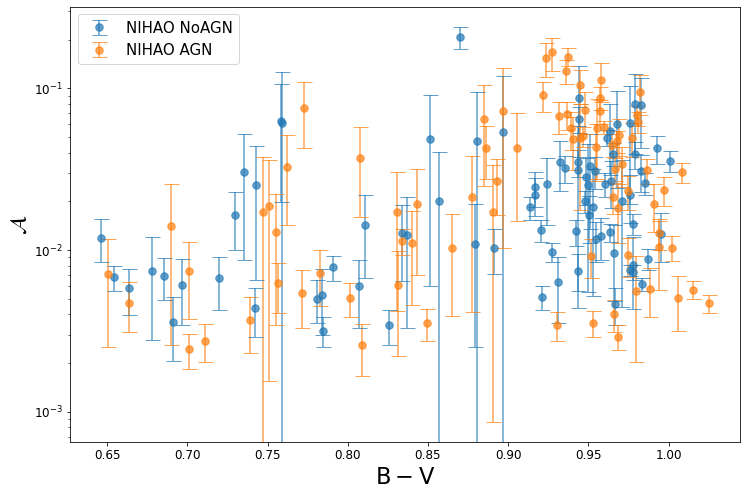

In [84]:
plt.figure(figsize=(12,8))
plt.errorbar(t_nihao['b_mag']-t_nihao['v_mag'],t_nihao['score_mean'],yerr=t_nihao['score_std'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO NoAGN')
plt.errorbar(t_nihao['b_mag_bh']-t_nihao['v_mag_bh'],t_nihao['score_mean_bh'],yerr=t_nihao['score_std_bh'],fmt='.',capsize=fontsize/2,markersize=fontsize,alpha=0.7,label='NIHAO AGN')
plt.yscale('log')
plt.xlabel('$\mathrm{B-V}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.legend(fontsize=fontsize)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

In [8]:
nik_nihao=QTable.read('NIHAO_AGN_params_with_SFR.csv')
nik_manga=QTable.read('MaNGA_dr17_structural_params_with_chem.csv')

In [9]:
nik_nihao=nik_nihao[0:-11]
nik_nihao

ID,Simulation,log_R10,Mstar_10,V_10,Sigma1,Mgas_10,SFR
str8,str3,float64,float64,float64,float64,float64,float64
g1.05e11,AGN,--,--,--,6.955014573,--,56700000.0
g1.08e11,AGN,0.4229741,8.552460237,1.683270567,7.404557422,8.427813303,38100000.0
g1.12e12,AGN,0.914640132,10.3975959,2.268061085,9.275935374,9.50601322,0.0
g1.37e11,AGN,0.619318796,9.202820498,1.938395829,7.938403217,9.025623775,94200000.0
g1.52e11,AGN,--,--,--,7.023275949,--,9342044.544
g1.57e11,AGN,0.206108972,8.003737843,1.291180397,7.158614723,7.61867583,73900000.0
g1.59e11,AGN,--,--,--,6.906197997,--,12900000.0
g1.64e11,AGN,--,--,--,6.529317112,--,482000000.0
g1.92e12,AGN,0.982266632,10.62833842,2.369100037,9.485449729,9.56600326,98337.31099


In [10]:
nik_nihao['score_mean']=0.
nik_nihao['score_std']=0.
for row in nik_nihao:
    if len(t_nihao[t_nihao['galaxy']==row['ID']])!=0:
        row['score_mean']=t_nihao[t_nihao['galaxy']==row['ID']]['score_mean_bh']
        row['score_std']=t_nihao[t_nihao['galaxy']==row['ID']]['score_std_bh']

In [11]:
nik_nihao=nik_nihao[nik_nihao['score_mean']!=0]

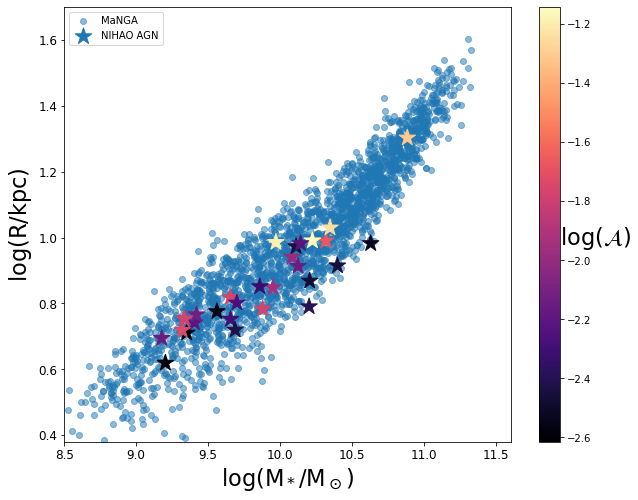

In [12]:
plt.figure(figsize=(10,8))
plt.scatter(nik_manga['Mstar_10'],nik_manga['log_R10'],label='MaNGA',alpha=0.5)
#sns.kdeplot(x=nik_manga['Mstar_10'],y=nik_manga['log_R10'],label='MaNGA',fill=True,levels=5)
plt.scatter(nik_nihao['Mstar_10'],nik_nihao['log_R10'],marker='*',s=300,label='NIHAO AGN',c=np.log10(nik_nihao['score_mean']),cmap='magma')
plt.legend()
plt.colorbar().set_label(label='$\mathrm{log}(\mathcal{A})$',size=fontsize*1.5,weight='bold',rotation=0)
plt.xlim(8.5,11.6)
plt.ylim(0.38,1.7)
plt.xlabel('$\mathrm{log(M_*/M_\odot)}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathrm{log(R/kpc)}$',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

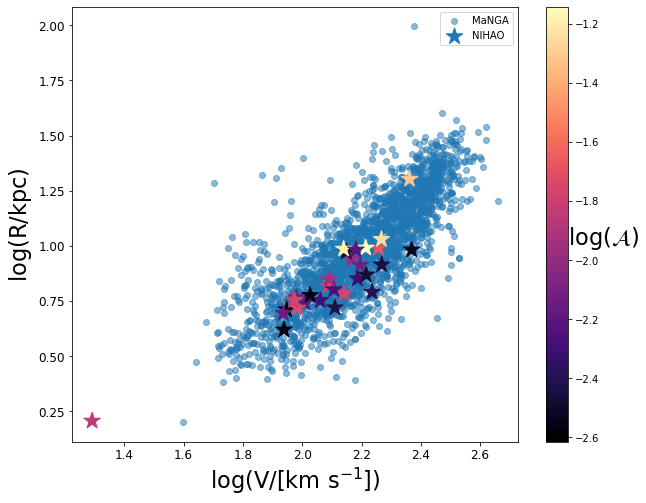

In [13]:
plt.figure(figsize=(10,8))
plt.scatter(nik_manga['V_10'],nik_manga['log_R10'],label='MaNGA',alpha=0.5)
#sns.kdeplot(x=nik_manga['Mstar_10'],y=nik_manga['log_R10'],label='MaNGA',fill=True,levels=5)
plt.scatter(nik_nihao['V_10'],nik_nihao['log_R10'],marker='*',s=300,label='NIHAO',c=np.log10(nik_nihao['score_mean']),cmap='magma')
plt.legend()
plt.colorbar().set_label(label='$\mathrm{log}(\mathcal{A})$',size=fontsize*1.5,weight='bold',rotation=0)
#plt.xlim(1.7,2.6)
#plt.ylim(8.5,11.6)
plt.xlabel('$\mathrm{log(V/[km\ s^{-1}])}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathrm{log(R/kpc)}$',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

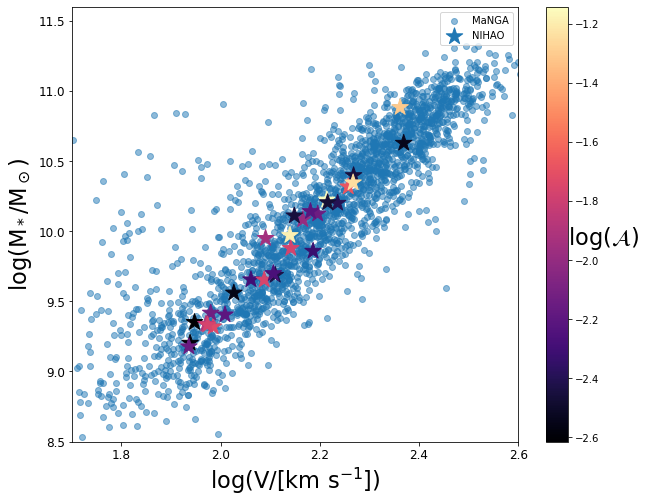

In [14]:
plt.figure(figsize=(10,8))
plt.scatter(nik_manga['V_10'],nik_manga['Mstar_10'],label='MaNGA',alpha=0.5)
#sns.kdeplot(x=nik_manga['Mstar_10'],y=nik_manga['log_R10'],label='MaNGA',fill=True,levels=5)
plt.scatter(nik_nihao['V_10'],nik_nihao['Mstar_10'],marker='*',s=300,label='NIHAO',c=np.log10(nik_nihao['score_mean']),cmap='magma')
plt.legend()
plt.xlim(1.7,2.6)
plt.ylim(8.5,11.6)
plt.colorbar().set_label(label='$\mathrm{log}(\mathcal{A})$',size=fontsize*1.5,weight='bold',rotation=0)
plt.xlabel('$\mathrm{log(V/[km\ s^{-1}])}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathrm{log(M_*/M_\odot)}$',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

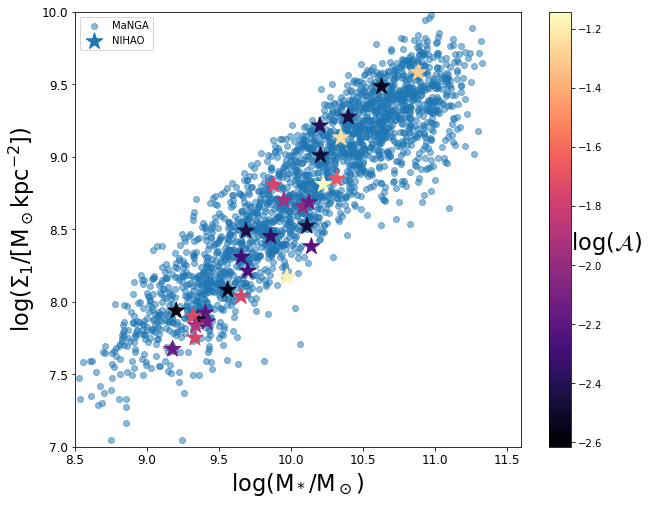

In [15]:
plt.figure(figsize=(10,8))
plt.scatter(nik_manga['Mstar_10'],nik_manga['Sigma1'],label='MaNGA',alpha=0.5)
plt.scatter(nik_nihao['Mstar_10'],nik_nihao['Sigma1'],marker='*',s=300,label='NIHAO',c=np.log10(nik_nihao['score_mean']),cmap='magma')
plt.legend()
plt.xlim(8.5,11.6)
plt.ylim(7,10)
plt.colorbar().set_label(label='$\mathrm{log}(\mathcal{A})$',size=fontsize*1.5,weight='bold',rotation=0)
plt.xlabel('$\mathrm{log(M_*/M_\odot)}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathrm{log(\Sigma_1/[M_\odot kpc^{-2}])}$',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

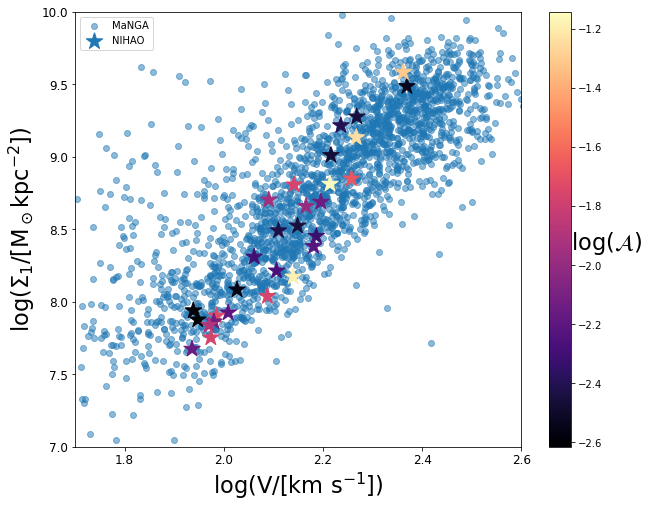

In [16]:
plt.figure(figsize=(10,8))
plt.scatter(nik_manga['V_10'],nik_manga['Sigma1'],label='MaNGA',alpha=0.5)
plt.scatter(nik_nihao['V_10'],nik_nihao['Sigma1'],marker='*',s=300,label='NIHAO',c=np.log10(nik_nihao['score_mean']),cmap='magma')
plt.legend()
plt.xlim(1.7,2.6)
plt.ylim(7,10)
plt.colorbar().set_label(label='$\mathrm{log}(\mathcal{A})$',size=fontsize*1.5,weight='bold',rotation=0)
plt.xlabel('$\mathrm{log(V/[km\ s^{-1}])}$',fontsize=fontsize*1.5)
plt.ylabel('$\mathrm{log(\Sigma_1/[M_\odot kpc^{-2}])}$',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

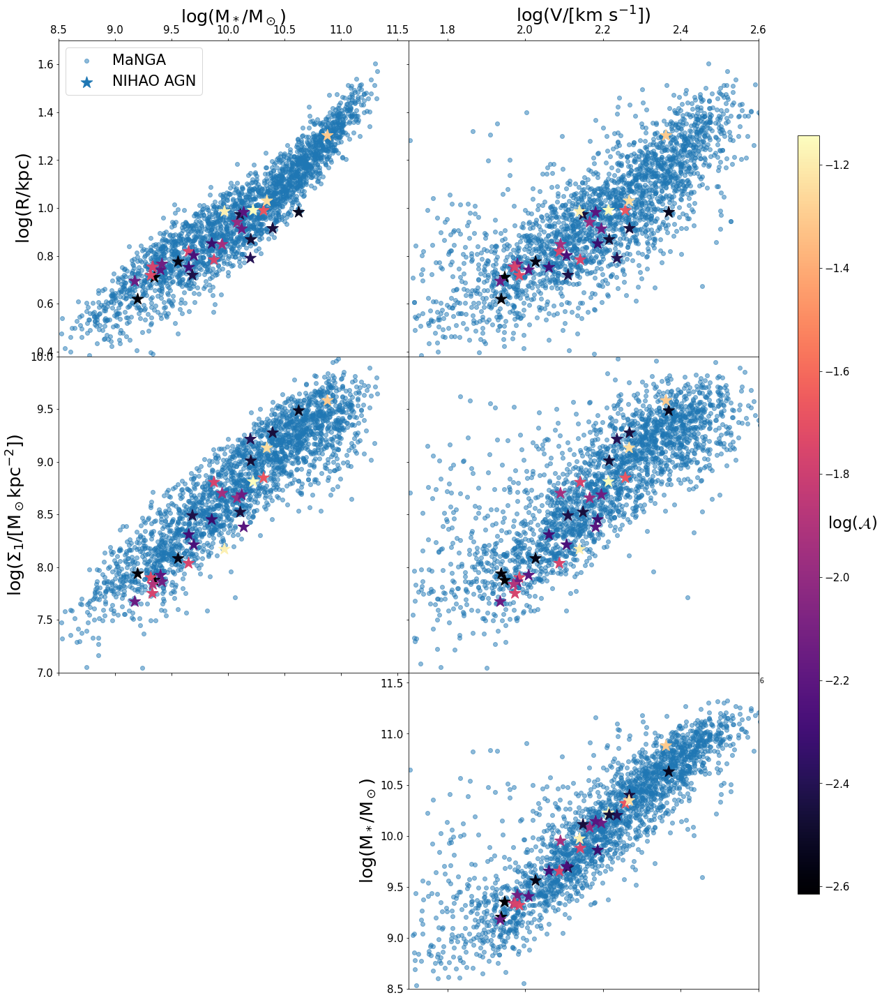

In [26]:
# Start with a square Figure.
fig = plt.figure(figsize=(20,25))
gs = fig.add_gridspec(3, 2,  width_ratios=(1,1), height_ratios=(1,1,1),wspace=0,hspace=0)

ax00=fig.add_subplot(gs[0, 0])
ax00.scatter(nik_manga['Mstar_10'],nik_manga['log_R10'],label='MaNGA',alpha=0.5)
cb=ax00.scatter(nik_nihao['Mstar_10'],nik_nihao['log_R10'],marker='*',s=300,label='NIHAO AGN',c=np.log10(nik_nihao['score_mean']),cmap='magma')
ax00.set_xlim(8.5,11.6)
ax00.set_ylim(0.38,1.7)
ax00.set_xlabel('$\mathrm{log(M_*/M_\odot)}$',fontsize=fontsize*1.7)
ax00.xaxis.set_label_position('top') 
ax00.xaxis.tick_top()
ax00.set_ylabel('$\mathrm{log(R/kpc)}$',fontsize=fontsize*1.7)
ax00.tick_params(axis='both', labelsize=fontsize)
ax00.legend(fontsize=fontsize*1.4)

ax01=fig.add_subplot(gs[0, 1],sharey=ax00)
ax01.scatter(nik_manga['V_10'],nik_manga['log_R10'],label='MaNGA',alpha=0.5)
ax01.scatter(nik_nihao['V_10'],nik_nihao['log_R10'],marker='*',s=300,label='NIHAO',c=np.log10(nik_nihao['score_mean']),cmap='magma')
ax01.set_xlabel('$\mathrm{log(V/[km\ s^{-1}])}$',fontsize=fontsize*1.7)
ax01.xaxis.set_label_position('top') 
ax01.xaxis.tick_top()
ax01.tick_params(axis='both', labelsize=fontsize)
plt.setp(ax01.get_yticklabels(), visible=False);

ax10=fig.add_subplot(gs[1, 0],sharex=ax00)
ax10.scatter(nik_manga['Mstar_10'],nik_manga['Sigma1'],label='MaNGA',alpha=0.5)
ax10.scatter(nik_nihao['Mstar_10'],nik_nihao['Sigma1'],marker='*',s=300,label='NIHAO',c=np.log10(nik_nihao['score_mean']),cmap='magma')
ax10.set_ylim(7,10)
#ax10.set_xlabel('$\mathrm{log(M_*/M_\odot)}$',fontsize=fontsize*1.5)
ax10.set_ylabel('$\mathrm{log(\Sigma_1/[M_\odot kpc^{-2}])}$',fontsize=fontsize*1.7)
ax10.tick_params(axis='both', labelsize=fontsize)
plt.setp(ax10.get_xticklabels(), visible=False);

ax11=fig.add_subplot(gs[1, 1],sharex=ax01,sharey=ax10)
ax11.scatter(nik_manga['V_10'],nik_manga['Sigma1'],label='MaNGA',alpha=0.5)
ax11.scatter(nik_nihao['V_10'],nik_nihao['Sigma1'],marker='*',s=300,label='NIHAO',c=np.log10(nik_nihao['score_mean']),cmap='magma')
plt.setp(ax11.get_yticklabels(), visible=False);

ax21=fig.add_subplot(gs[2, 1],sharex=ax11)
ax21.scatter(nik_manga['V_10'],nik_manga['Mstar_10'],label='MaNGA',alpha=0.5)
ax21.scatter(nik_nihao['V_10'],nik_nihao['Mstar_10'],marker='*',s=300,label='NIHAO',c=np.log10(nik_nihao['score_mean']),cmap='magma')
ax21.set_xlim(1.7,2.6)
ax21.set_ylim(8.5,11.6)
#ax21.set_xlabel('$\mathrm{log(V/[km\ s^{-1}])}$',fontsize=fontsize*1.5)
ax21.set_ylabel('$\mathrm{log(M_*/M_\odot)}$',fontsize=fontsize*1.7)
ax21.tick_params(axis='both', labelsize=fontsize)
plt.setp(ax21.get_xticklabels(), visible=False);

cbar=fig.colorbar(cb,ax=[ax00,ax01,ax10,ax11,ax21],
            fraction=0.05,aspect=35,shrink=0.8)
cbar.set_label(label='$\mathrm{log}(\mathcal{A})$',size=fontsize*1.5,weight='bold',rotation=0)
cbar.ax.tick_params(labelsize=fontsize)




#ax.set_xlabel('$\mathrm{Z\ [Z_{\odot}]}$',fontsize=fontsize*1.5)
#ax.set_ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
#ax.legend(fontsize=fontsize)
#ax.tick_params(axis='both', labelsize=fontsize*0.8)

Setting up a new session...


   Loaded weights.


100%|██████████| 1/1 [00:00<00:00,  7.95it/s]


array([0.0267757])

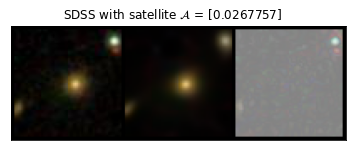

In [94]:
fn=np.array([os.path.basename(x) for x in glob.glob('data/fun/*')])
fn.sort()
visualize_list(fn[:1],folder='data/fun/',plot=1,plotname='SDSS with satellite')

Setting up a new session...


   Loaded weights.


100%|██████████| 1/1 [00:00<00:00,  7.96it/s]


array([0.02770448])

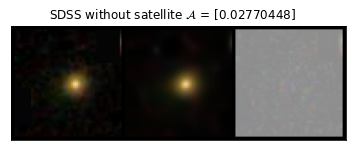

In [95]:
visualize_list(fn[1:2],folder='data/fun/',plot=1,plotname='SDSS without satellite')

Setting up a new session...


   Loaded weights.


100%|██████████| 240/240 [00:11<00:00, 20.93it/s]


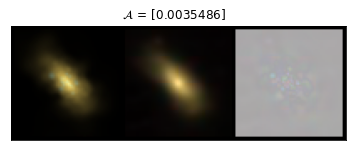

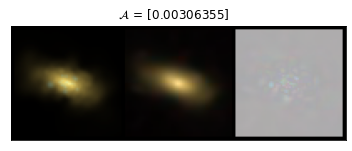

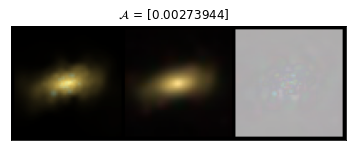

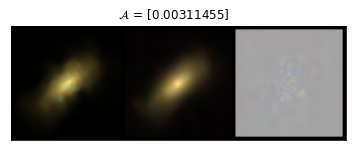

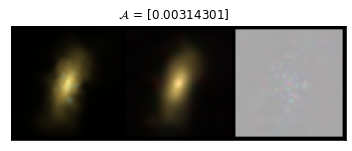

...

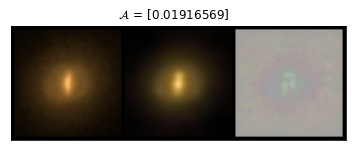

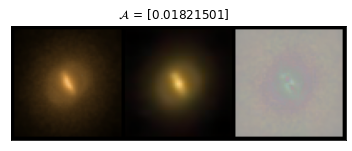

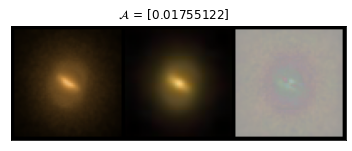

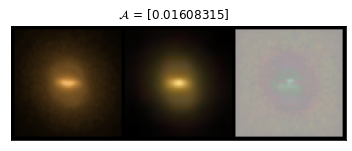

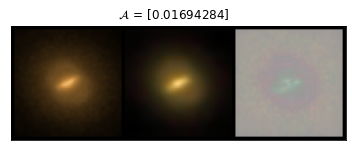

In [96]:
fn=np.array([os.path.basename(x) for x in glob.glob('data/orientation/*zrot*')])
fn.sort()
zrot_array=visualize_list(fn,folder='data/orientation/',plot=1)

In [97]:
zrot_array.resize(20,12)
dummy=np.zeros((20,13))
for i in range(20):
    dummy[i][:-1]=zrot_array[i]
    dummy[i][-1]=zrot_array[i][0]
zrot_array=dummy

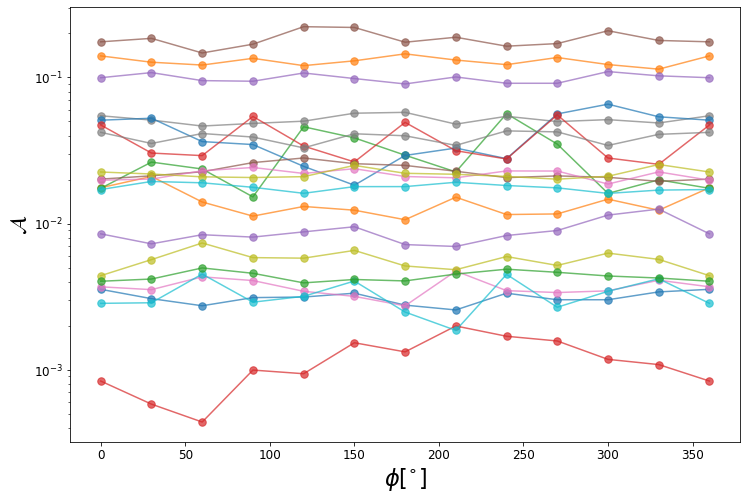

In [98]:
plt.figure(figsize=(12,8))
zangles=np.linspace(0,360,13)
for i in range(20):
    plt.plot(zangles,zrot_array[i],marker='.',markersize=fontsize,alpha=0.7)
plt.yscale('log')
plt.xlabel('$\phi [^{\circ}]$',fontsize=fontsize*1.5)
plt.ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

Setting up a new session...


   Loaded weights.


100%|██████████| 240/240 [00:11<00:00, 20.09it/s]


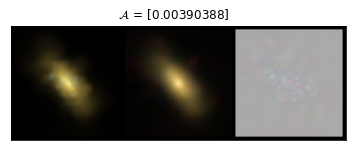

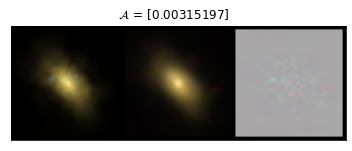

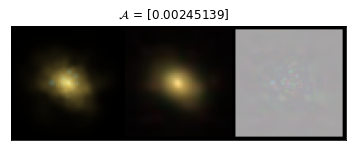

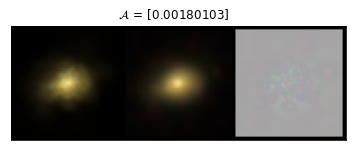

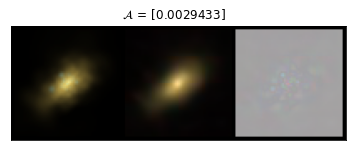

...

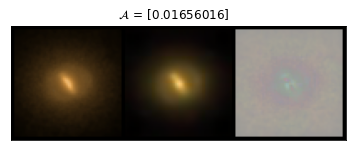

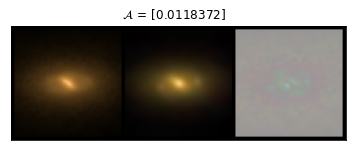

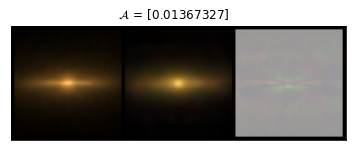

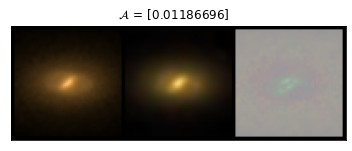

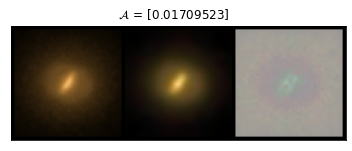

In [99]:
fn=np.array([os.path.basename(x) for x in glob.glob('data/orientation/*xrot*')])
fn.sort()
xrot_array=visualize_list(fn,folder='data/orientation/',plot=1)

In [100]:
xrot_array.resize(20,12)
dummy=np.zeros((20,13))
for i in range(20):
    dummy[i][:-1]=xrot_array[i]
    dummy[i][-1]=xrot_array[i][0]
xrot_array=dummy

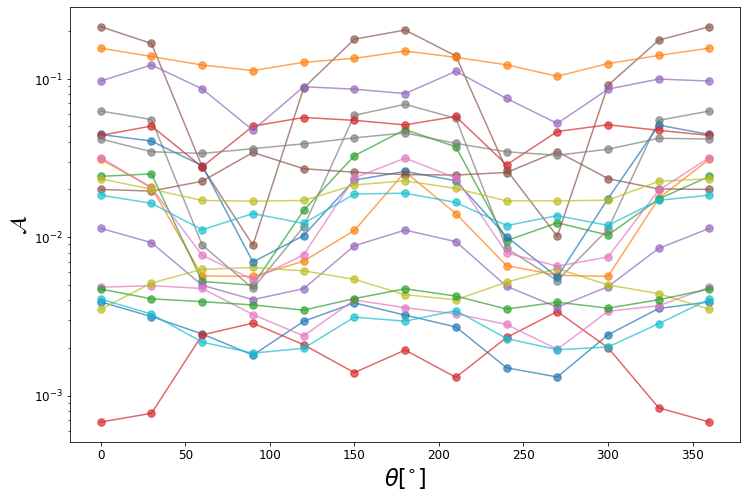

In [101]:
plt.figure(figsize=(12,8))
xangles=np.linspace(0,360,13)
for i in range(20):
    plt.plot(xangles,xrot_array[i],marker='.',markersize=fontsize,alpha=0.7)
plt.yscale('log')
plt.xlabel(r'$\theta [^{\circ}]$',fontsize=fontsize*1.5)
plt.ylabel('$\mathcal{A}$',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);

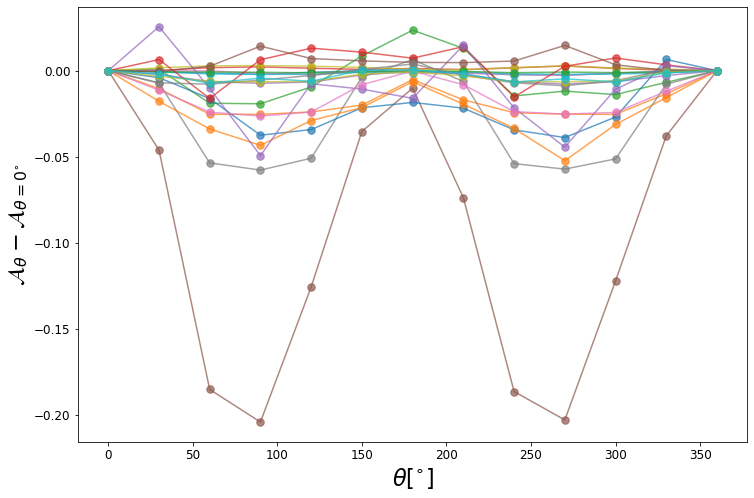

In [102]:
plt.figure(figsize=(12,8))
xangles=np.linspace(0,360,13)
for i in range(20):
    plt.plot(xangles,xrot_array[i]-xrot_array[i][0],marker='.',markersize=fontsize,alpha=0.7)
plt.xlabel(r'$\theta [^{\circ}]$',fontsize=fontsize*1.5)
plt.ylabel(r'$\mathcal{A}_{\theta}-\mathcal{A}_{\theta=0^{\circ}}$',fontsize=fontsize*1.5)
plt.xticks(fontsize=fontsize*0.8)
plt.yticks(fontsize=fontsize*0.8);